In [39]:
# Packages that need to be imported
import json
import re
import os
import subprocess
from ete3 import Tree
# Statistical test
import pandas as pd
import numpy as np
from scipy.stats import pearsonr
#figure
from collections import Counter
import matplotlib.pyplot as plt
from matplotlib import pyplot as plt
from matplotlib import colors as ce
import re
from pylab import *
from Bio import SeqIO
from cmcrameri import cm


In [40]:
#contexmanager cd
class cd:
    """Context manager for changing the current working directory"""
    def __init__(self, newPath):
        self.newPath = os.path.expanduser(newPath)

    def __enter__(self):
        self.savedPath = os.getcwd()
        os.chdir(self.newPath)

    def __exit__(self, etype, value, traceback):
        os.chdir(self.savedPath)

In [41]:
# Al data that you need to run this script and create the figures
Speciesorder = ['SARC', 'CFRA', 'COWC', 'MBRE', 'SROS', 'AQUE', 'TADH', 'ADIG', 'NVEC', 'HVUL', 'AVAG', 'ILIN', 'SMED', 'TASI', 'SMAN', 'CTEL', 'LGIG', 'CGIG', 'OBIM', 'PCAU', 'TSPI', 'BMAL', 'CELE', 'RVAR', 'SMIM', 'LPOL', 'HAZT', 'DPUL', 'DMEL', 'AGAM', 'BMOR', 'TCAS', 'APIS', 'PHUM', 'SKOW', 'SPUR', 'BFLO', 'ODIO', 'CINT', 'CMIL', 'DRER', 'TRUB', 'XTRO', 'APLA', 'PSIN', 'OANA', 'HSAP', 'NUSP', 'FALB', 'RALL', 'MDAP', 'EINT', 'PSPF', 'NSPE', 'SPUN', 'BDEN', 'AMAC', 'CANG', 'BMER', 'CCOR', 'SPLU', 'CREV', 'RBRE', 'RIRR', 'MVER', 'MELO', 'MCIR', 'PBLA', 'UMAY', 'MLAR', 'RSPE', 'CNEO', 'ABIS', 'SCOM', 'SPOM', 'SCER', 'KLAC', 'YLIP', 'NCRA', 'TMEL', 'TTRA', 'ACAS', 'EHIS', 'EINV', 'DDIS', 'PPAL', 'ASUB', 'EHUX', 'CTOB', 'BHOM', 'AKER', 'SAGG', 'ALIM', 'PINF', 'PHAL', 'HPAR', 'PULT', 'ALAI', 'AAST', 'SPAR', 'ESIL', 'COKA', 'NGAD', 'AANO', 'PTRI', 'FCYL', 'TPSE', 'CVEL', 'VBRA', 'GNIP', 'CPAI', 'CMUR', 'BBIG', 'TANN', 'PFAL', 'TGON', 'EACE', 'PMAR', 'SMIC', 'SMIN', 'SCOE', 'SLEM', 'OTRI', 'TTHE', 'IMUL', 'PPER', 'PTET', 'BNAT', 'RFIL', 'PBRA', 'GTHE', 'CPAR', 'GSUL', 'CMER', 'PPUR', 'CCRI', 'KFLA', 'MPOL', 'PPAT', 'SFAL', 'SMOE', 'PABI', 'ATRI', 'OSAT', 'ACOE', 'NNUC', 'ATHA', 'MSPE', 'OLUC', 'CVAR', 'CSUB', 'CREI', 'VCAR', 'MNEG', 'MONO', 'TVAG', 'GINT', 'SSAL', 'LMAJ', 'ADEA', 'SCUL', 'PHYT', 'TBRU', 'BSAL', 'PERK', 'EGRA', 'NGRU']
profiles = {}

for l in open('../eggnog_hmmer_corrected.txt'):
    l = l.split()
    profiles[l[0]+'_'+l[1]] = l[2]


egg_corrected_profiles ={}
for line in open('/home/laurar/laurar2/Data/eukarya/annotations/eggnog/Orthogroups_EggNOG_hmmer_corrected.txt'):
    line.split(':')[1]
    profile_vectors = [0]*len(Speciesorder)
    for i,species in enumerate(Speciesorder):
        if species in line.split(':')[1]:
            profile_vectors[i] = 1
    egg_corrected_profiles[line.split(':')[0]]=profile_vectors
    


In [14]:
for line in open('/home/laurar/laurar2/Data/eukarya/annotations/eggnog/Orthogroups_EggNOG_hmmer_corrected.txt'):
    if line.startswith('KOG1597'):
        line.split(':')[1]
        profile_vectors = [0]*len(Speciesorder)
        for i,species in enumerate(Speciesorder):
            for sp in line.split(':')[1].split():
                if species in sp :
                    profile_vectors[i] += 1
        KOG1597=profile_vectors
print(KOG1597)

[1, 2, 1, 1, 1, 7, 1, 1, 1, 2, 5, 1, 15, 1, 1, 1, 1, 1, 1, 2, 0, 1, 1, 2, 2, 2, 3, 4, 1, 2, 1, 1, 1, 1, 1, 5, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 2, 1, 1, 4, 1, 1, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 0, 1, 2, 2, 0, 0, 0, 0, 0, 0, 1, 2, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 0, 3, 1, 1, 0, 0, 0, 0, 1, 1, 1, 2, 1, 1, 2, 2, 2, 1, 5, 2, 5, 2, 8, 2, 6, 5, 2, 6, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1]


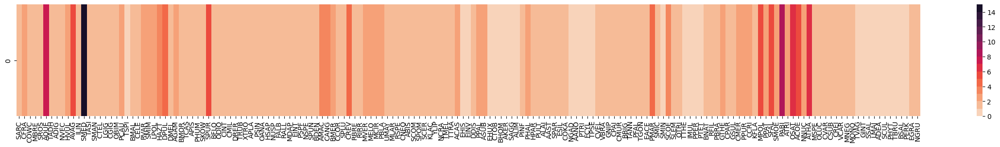

In [38]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns


a = np.array(KOG1597)
fig, ax = plt.subplots(figsize = (30,3))
sns.heatmap([a],xticklabels=Speciesorder,cmap=sns.color_palette("rocket_r",15))
fig.savefig("KOG1597_number_of_orthologous_per_species.png") 

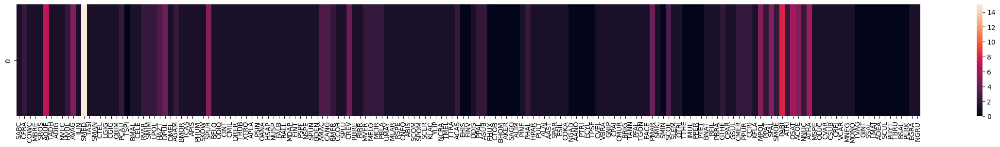

In [42]:
# Functions for the automated figures
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import math



def present_absent_motif_list_logo(motif_list, name_file,mode):
    fig, axes = plt.subplots(nrows=len(motif_list),ncols=2, figsize=(30, 5*len(motif_list)),gridspec_kw={'width_ratios': [2, 1]})
    
    for i, motif in enumerate(motif_list):
        m = motif.split('_')
        profiles_KOG = {}
        profile_vectors = [0] * len(Speciesorder)
        
        for j, species in enumerate(Speciesorder):
            if species in motifs_pa[mode][m[0] + '_' + m[1]][m[2]]:
                profile_vectors[j] = 1
                
        profiles_KOG[m[2]] = profile_vectors
        profiles_KOG[m[0]] = egg_corrected_profiles[m[0]]
        profiles_KOG[m[1]] = egg_corrected_profiles[m[1]]
        
        heatmap = pd.DataFrame({k:list(v) for k, v in profiles_KOG.items()}).T.fillna(0).astype(int)
        heatmap.columns = Speciesorder
        heatmap = heatmap.loc[[m[0], m[1], m[2]]]
        
        cmap = ce.ListedColormap(['w','#1E2156'])
        axes[i][0].pcolor(heatmap, cmap=cmap)
        axes[i][0].set_yticks(np.arange(0.5, len(heatmap.index), 1))
        axes[i][0].set_yticklabels(heatmap.index)
        axes[i][0].set_xticks(np.arange(0.5, len(heatmap.columns), 1))
        axes[i][0].set_xticklabels(heatmap.columns, rotation=90)
        axes[i][0].invert_yaxis()
        axes[i][0].set_title(motif)
        
        # Load the image and add it to the current row
        img = mpimg.imread(location_png[mode][m[0] + '_' + m[1]][m[2]])
        axes[i][1].imshow(img)
        axes[i][1].axis('off')
        
    plt.tight_layout()
    plt.savefig('/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/motif_interst_rerun/'+name_file+'.pdf')
    plt.show()
    
def present_absent_motif(motif,mode):
    m=motif.split('_')
    profiles_KOG= {}
    profile_vectors = [0]*len(Speciesorder)
    for i,species in enumerate(Speciesorder):
        if species in motifs_pa[mode][m[0]+'_'+m[1]][m[2]]:
            profile_vectors[i] = 1
    profiles_KOG[m[2]]=profile_vectors
    profiles_KOG[m[0]]=egg_corrected_profiles[m[0]]
    profiles_KOG[m[1]]=egg_corrected_profiles[m[1]]
    heatmap = pd.DataFrame({k:list(v) for k, v in profiles_KOG.items()}).T.fillna(0).astype(int)
    heatmap.columns = Speciesorder
    heatmap=heatmap.loc[[m[0], m[1], m[2]]]
    plt.figure(figsize=(20, 5))
    cmap = ce.ListedColormap(['w','#1E2156'])
    plt.pcolor(heatmap,cmap = cmap)
    plt.yticks(np.arange(0.5, len(heatmap.index), 1), heatmap .index)
    plt.xticks(np.arange(0.5, len(heatmap.columns), 1),heatmap.columns,rotation=90)
    plt.gca().invert_yaxis()
    plt.savefig('/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/motif_interst_rerun/'+motif+'.pdf')
    plt.show()
    
def present_absent_motif_list(motif_list, name_file, mode):
    fig, axes = plt.subplots(nrows=len(motif_list), figsize=(20, 5*len(motif_list)))
    
    for i, motif in enumerate(motif_list):
        m = motif.split('_')
        profiles_KOG = {}
        profile_vectors = [0] * len(Speciesorder)
        
        for j, species in enumerate(Speciesorder):
            if species in motifs_pa[mode][m[0] + '_' + m[1]][m[2]]:
                profile_vectors[j] = 1
                
        profiles_KOG[m[2]] = profile_vectors
        profiles_KOG[m[0]] = egg_corrected_profiles[m[0]]
        profiles_KOG[m[1]] = egg_corrected_profiles[m[1]]
        
        heatmap = pd.DataFrame({k:list(v) for k, v in profiles_KOG.items()}).T.fillna(0).astype(int)
        heatmap.columns = Speciesorder
        heatmap = heatmap.loc[[m[0], m[1], m[2]]]
        
        cmap = ce.ListedColormap(['w','#1E2156'])
        axes[i].pcolor(heatmap, cmap=cmap)
        axes[i].set_yticks(np.arange(0.5, len(heatmap.index), 1))
        axes[i].set_yticklabels(heatmap.index)
        axes[i].set_xticks(np.arange(0.5, len(heatmap.columns), 1))
        axes[i].set_xticklabels(heatmap.columns, rotation=90)
        axes[i].invert_yaxis()
        axes[i].set_title(motif)
        
    plt.tight_layout()
    plt.savefig('//home/laurar/laurar2/Protein_motive_evo/ProteinMotif/motif_interst_rerun/'+name_file+'.pdf')
    plt.show()

def split_list(lst, parts):
    # Calculate the length of each part
    n = len(lst) // parts
    # Calculate any remainder
    r = len(lst) % parts
    # Create a list to store the parts
    result = []
    # Initialize the starting index for each part
    start = 0
    # Loop over the number of parts
    for i in range(parts):
        # Calculate the ending index for this part
        end = start + n + (1 if i < r else 0)
        # Add this part to the result list
        result.append(lst[start:end])
        # Update the starting index for the next part
        start = end
    return result

from matplotlib.backends.backend_pdf import PdfPages
def split_list2(lst, chunk_size):
     return [lst[i:i + chunk_size] for i in range(0, len(lst), chunk_size)]

def present_absent_motif_list_logo_pages(motif_list, name_file, mode, rows_per_page=5):
    total_subfigures = len(motif_list)
    total_pages = math.ceil(total_subfigures / rows_per_page)
    motif_list=split_list2(motif_list,rows_per_page)
    with PdfPages('/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/motif_interst_rerun/'+name_file + '.pdf') as pdf:
        for page_num in range(total_pages):
            fig, axes = plt.subplots(nrows=rows_per_page, ncols=2, figsize=(8.27,11.69),gridspec_kw={'width_ratios': [3, 1]})  # A4 size in inches (portrait)

            for i, motif in enumerate(motif_list[page_num]):
                m = motif.split('_')
                profiles_KOG = {}
                profile_vectors = [0] * len(Speciesorder)

                for j, species in enumerate(Speciesorder):
                    if species in motifs_pa[mode][m[0] + '_' + m[1]][m[2]]:
                        profile_vectors[j] = 1

                profiles_KOG[m[2]] = profile_vectors
                profiles_KOG[m[0]] = egg_corrected_profiles[m[0]]
                profiles_KOG[m[1]] = egg_corrected_profiles[m[1]]

                heatmap = pd.DataFrame({k:list(v) for k, v in profiles_KOG.items()}).T.fillna(0).astype(int)
                heatmap.columns = Speciesorder
                heatmap = heatmap.loc[[m[0], m[1], m[2]]]

                cmap = ce.ListedColormap(['w','#1E2156'])
                axes[i][0].pcolor(heatmap, cmap=cmap)
                axes[i][0].set_yticks(np.arange(0.5, len(heatmap.index), 1))
                axes[i][0].set_yticklabels(heatmap.index,fontsize=6)
                axes[i][0].set_xticks(np.arange(0.5, len(heatmap.columns), 1))
                axes[i][0].set_xticklabels(heatmap.columns, rotation=90,fontsize=5)
                axes[i][0].invert_yaxis()
                axes[i][0].set_title(motif)

                # Load the image and add it to the current row
                img = mpimg.imread(location_png[mode][m[0] + '_' + m[1]][m[2]])
                axes[i][1].imshow(img)
                axes[i][1].axis('off')
             # Remove any empty rows at the end of the page
            for j in range(i + 1, rows_per_page):
                fig.delaxes(axes[j][0])
                fig.delaxes(axes[j][1])
            plt.tight_layout()
            pdf.savefig(fig)
            plt.show()

In [43]:
location_png = {}
Direc = '../rerun_meme_mast/Eggnog_corrected_pairs/'
location_png['differential'] = {}
for dirt in os.listdir(Direc):
    dic_chi_square = {}
    location_png['differential'][dirt]={}
    with cd(Direc):
        for file in os.listdir(dirt):
            if file.endswith('.png'):
                location_png['differential'][dirt]['MEME-'+file.split('.')[0][4:]]='/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/rerun_meme_mast/Eggnog_corrected_pairs/'+dirt+'/'+file

Direc = '../meme-output/Eggnog_corrected_pairs/'
location_png['discrimative'] = {}
for dirt in os.listdir(Direc):
    dic_chi_square = {}
    location_png['discrimative'][dirt]={}
    with cd(Direc):
        for file in os.listdir(dirt):
            if file.endswith('.png'):
                location_png['discrimative'][dirt]['MEME-'+file.split('.')[0][4:]]='/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/meme-output/Eggnog_corrected_pairs/'+dirt+'/'+file
                
Direc = '../classic_meme/classic_meme_/home/fasta_eggnog_corrected/'
location_png['classic'] = {}
for dirt in os.listdir(Direc):
    dic_chi_square = {}
    dirt1=dirt.split('.')[0]
    location_png['classic'][dirt1]={}
    with cd(Direc):
        for file in os.listdir(dirt):
            if file.endswith('.png'):
                location_png['classic'][dirt1]['MEME-'+file.split('.')[0][4:]]='/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/classic_meme/classic_meme_/home/fasta_eggnog_corrected/'+dirt+'/'+file
                   
Direc = '../Manual_orhtologs_groups/Meme_run/'

for dirt in os.listdir(Direc):
    dic_chi_square = {}
    location_png['differential'][dirt]={}
    with cd(Direc):
        for file in os.listdir(dirt):
            if file.endswith('.png'):
                location_png['differential'][dirt]['MEME-'+file.split('.')[0][4:]]='/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/Manual_orhtologs_groups/Meme_run/'+dirt+'/'+file

Direc = '../Manual_orhtologs_groups/discordant_motifs/'
for dirt in os.listdir(Direc):
    dic_chi_square = {}
    location_png['discrimative'][dirt]={}
    with cd(Direc):
        for file in os.listdir(dirt):
            if file.endswith('.png'):
                location_png['discrimative'][dirt]['MEME-'+file.split('.')[0][4:]]='/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/Manual_orhtologs_groups/discordant_motifs/'+dirt+'/'+file
Direc = '../Manual_orhtologs_groups/Classic_meme/'
for dirt in os.listdir(Direc):
    dic_chi_square = {}
    location_png['classic'][dirt]={}
    with cd(Direc):
        for file in os.listdir(dirt):
            if file.endswith('.png'):
                location_png['classic'][dirt]['MEME-'+file.split('.')[0][4:]]='/home/laurar/laurar2/Protein_motive_evo/ProteinMotif/Manual_orhtologs_groups/Classic_meme/'+dirt+'/'+file



In [20]:
location_png['discrimative'

SyntaxError: unexpected EOF while parsing (2492466935.py, line 1)

In [44]:
eggnog_hmm = {}
for line in open('/home/laurar/laurar2/Data/eukarya/annotations/eggnog/Orthogroups_EggNOG_hmmer_corrected.txt'):
    line = line.split(':')
#    if line[1].count('HSAP') > 0:
    eggnog_hmm[line[0]]=line[1].count('HSAP')

In [45]:
# we notice that we have mainly find motifs that are only present in opistokonta
# and think that this is mainly phylogenetic signal and not 'real' motifs
#define the supergroups
supergroupsLeft = ["Excavata","Archaeplastida","SAR","Haptophyta"]
supergroupsRight = ["Amoebozoa","Opisthokonta"]
#read in tree
tree = Tree('/home/laurar/laurar2/Data/eukarya/data_set/trees/eukarya_species.core.annotated.newick', format = 1)
superleft = {}
superright = {}
for i in supergroupsLeft:
    superleft[i]=[]
    node = tree.search_nodes(name=i)[0]
    for leaf in node:
        superleft[i]+=[leaf.name]
for i in supergroupsRight:
    superright[i]=[]
    node = tree.search_nodes(name=i)[0]
    for leaf in node:
        superright[i]+=[leaf.name]

bigger_group = superright | superleft 


In [328]:
bigger_group

{'Amoebozoa': ['ACAS', 'EHIS', 'EINV', 'DDIS', 'PPAL', 'ASUB'],
 'Opisthokonta': ['SARC',
  'CFRA',
  'COWC',
  'MBRE',
  'SROS',
  'AQUE',
  'TADH',
  'ADIG',
  'NVEC',
  'HVUL',
  'AVAG',
  'ILIN',
  'SMED',
  'TASI',
  'SMAN',
  'CTEL',
  'LGIG',
  'CGIG',
  'OBIM',
  'PCAU',
  'TSPI',
  'BMAL',
  'CELE',
  'RVAR',
  'SMIM',
  'LPOL',
  'HAZT',
  'DPUL',
  'DMEL',
  'AGAM',
  'BMOR',
  'TCAS',
  'APIS',
  'PHUM',
  'SKOW',
  'SPUR',
  'BFLO',
  'ODIO',
  'CINT',
  'CMIL',
  'DRER',
  'TRUB',
  'XTRO',
  'APLA',
  'PSIN',
  'OANA',
  'HSAP',
  'NUSP',
  'FALB',
  'RALL',
  'MDAP',
  'EINT',
  'PSPF',
  'NSPE',
  'SPUN',
  'BDEN',
  'AMAC',
  'CANG',
  'BMER',
  'CCOR',
  'SPLU',
  'CREV',
  'RBRE',
  'RIRR',
  'MVER',
  'MELO',
  'MCIR',
  'PBLA',
  'UMAY',
  'MLAR',
  'RSPE',
  'CNEO',
  'ABIS',
  'SCOM',
  'SPOM',
  'SCER',
  'KLAC',
  'YLIP',
  'NCRA',
  'TMEL'],
 'Excavata': ['MONO',
  'TVAG',
  'GINT',
  'SSAL',
  'LMAJ',
  'ADEA',
  'SCUL',
  'PHYT',
  'TBRU',
  'BSAL',
  'PERK

# Run pearson Distance 

first for the differential enrichment MEME

In [46]:
Direc = '../rerun_meme_mast/Eggnog_corrected_pairs/'
entries = os.listdir(Direc)
motifs_ents = {}
motifs_pa = {}
motifs_ents['differential'] = {}
motifs_pa['differential'] = {}
for dirt in entries:
    dic_chi_square = {}
    with cd(Direc+dirt):
        try:
            with open('meme.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))
                meme_motif = {}
                for l in range(len(meme_json["motifs"])):
                    meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"]
                    
            with open('mast_out/mast.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))

                mast_out = {}
                db_motif = {}
                for l in range(len(meme_json["motifs"])):
                    db_motif[l]=meme_json["motifs"][l]['alt']
                for i in range(len(meme_json['sequences'])):
                    if meme_json['sequences'][i]['name'][:4] not in mast_out:
                        mast_out[meme_json['sequences'][i]['name'][:4]]=[]
                    if 'segs' in meme_json['sequences'][i]:
                        for j in range(len(meme_json['sequences'][i]['segs'])):
                            for m in meme_json['sequences'][i]['segs'][j]['hits']:
                                if m['idx'] not in mast_out[meme_json['sequences'][i]['name'][:4]]:
                                    if m['pvalue']<1e-7:
                                        mast_out[meme_json['sequences'][i]['name'][:4]]+= [db_motif[m['idx']]]

                motifs ={}
                for i in mast_out:
                    for j in mast_out[i]:
                        if j not in motifs:
                            motifs[j]=[]
                        if i not in motifs[j]:
                            motifs[j]+= [i]
                motifs_pa['differential'][dirt]=motifs
                
                for motif in motifs:
                    dic_chi_square[motif]= []
                    b=[]
                    m=[]
                    for index, value in enumerate(profiles[dirt]):
                        if value == '+' and Speciesorder[index] in motifs[motif]:
                            b.append(1)
                            m.append(1)
                        if value == '+' and Speciesorder[index] not in motifs[motif]:
                            b.append(1)
                            m.append(0)
                        if value == 'a' and Speciesorder[index] in motifs[motif]:
                            b.append(0)
                            m.append(1)
                        if value == 'a' and Speciesorder[index] not in motifs[motif]:
                            b.append(0)
                            m.append(0)
                    if len(b)==b.count(0) or len(b)==b.count(1):
                        if b[0] == 1:
                            b.append(0)
                            m.append(0)
                        if b[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'b')

                    if len(m)==m.count(0) or len(m)==m.count(1):
                        if m[0] == 1:
                            b.append(0)
                            m.append(0)
                        if m[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'm') 
                    r,p = pearsonr(b,m)
                    dic_chi_square[motif]=[r,p]
        except:
            print(dirt)

    motifs_ents['differential'][dirt]=dic_chi_square               
                    
                    
                    

Every position in the list has the same value: KOG1748@euNOG_KOG4548@euNOG MEME-1 m
Every position in the list has the same value: KOG0174@euNOG_KOG3112@euNOG MEME-2 m
Every position in the list has the same value: KOG0469@euNOG_KOG0115@euNOG MEME-7 m
Every position in the list has the same value: KOG0469@euNOG_KOG0115@euNOG MEME-5 m
Every position in the list has the same value: KOG0469@euNOG_KOG0115@euNOG MEME-6 m
Every position in the list has the same value: KOG0335@euNOG_KOG0117@euNOG MEME-5 m
Every position in the list has the same value: KOG0733@euNOG_KOG2561@euNOG MEME-7 m
Every position in the list has the same value: KOG0733@euNOG_KOG2561@euNOG MEME-5 m
Every position in the list has the same value: KOG0085@euNOG_0II16@euNOG MEME-10 m
Every position in the list has the same value: KOG0085@euNOG_0II16@euNOG MEME-5 m
Every position in the list has the same value: KOG0070@euNOG_KOG1928@euNOG MEME-8 m
Every position in the list has the same value: KOG1342@euNOG_KOG2294@euNOG MEME

Every position in the list has the same value: KOG0356@euNOG_KOG4227@euNOG MEME-7 m
Every position in the list has the same value: KOG0356@euNOG_KOG4227@euNOG MEME-6 m
Every position in the list has the same value: KOG0043@euNOG_KOG3523@euNOG MEME-1 m
Every position in the list has the same value: KOG0952@euNOG_KOG2950@euNOG MEME-5 m
Every position in the list has the same value: KOG0952@euNOG_KOG2950@euNOG MEME-4 m
Every position in the list has the same value: KOG0292@euNOG_KOG3081@euNOG MEME-8 m
Every position in the list has the same value: KOG1687@euNOG_KOG3389@euNOG MEME-1 m
Every position in the list has the same value: KOG0663@euNOG_KOG4062@euNOG MEME-1 m
Every position in the list has the same value: KOG2779@euNOG_0IVVZ@euNOG MEME-8 m
Every position in the list has the same value: KOG2467@euNOG_0IPEG@euNOG MEME-9 m
Every position in the list has the same value: KOG1342@euNOG_KOG4299@euNOG MEME-4 m
KOG0830@euNOG_KOG3502@euNOG
KOG0668@euNOG_KOG4626@euNOG
Every position in the li

In [47]:
LECA_motif_differential = []
for p in motifs_pa['differential']:
    for j in motifs_pa['differential'][p]:
        superCountleft = 0 # counter for the left side of the root to check if there is a left side
        superCountright = 0 # counter for right side
        for i in superleft:
            for item in motifs_pa['differential'][p][j]:
                if item in superleft[i]:
                    superCountleft += 1
                    break
        for i in superright:
            for item in motifs_pa['differential'][p][j]:
                if item in superright[i]:
                    superCountright += 1
                    break
        superCount = superCountright + superCountleft # total supergroups must be 3 or higher

        #If root is found, presence is in both left and right root, and total supergroup presence is 3 or largers, we found a LECA PFAM
        if (superCount >= 3) & (superCountleft >= 1) & (superCountright >= 1):
            LECA_motif_differential.append(p+'_'+j)

new_dic={}
for eggs in motifs_ents['differential']:
    p = eggs.split('_')
    for mots in motifs_ents['differential'][eggs]:
        new_dic[eggs+'_'+str(mots)] = motifs_ents['differential'][eggs][mots]+ [eggnog_hmm[p[0]]]
leca_dic_differential ={}
for i in LECA_motif_differential:
    leca_dic_differential[i]= new_dic[i]

dat_differential = pd.DataFrame.from_dict(leca_dic_differential, orient='index',columns=['correlation','pvalue','human_hsap'])
dat_differential = dat_differential.sort_values(by=['correlation'], ascending=False)
dat_differential.head(20)

dat_differential.to_csv('../pearson_corrolation_differntial.csv')

second for discrimative motifs

In [48]:
Direc = '../meme-output/Eggnog_corrected_pairs/'
entries = os.listdir(Direc)
motifs_ents['discrimative'] = {}
motifs_pa['discrimative'] = {}
for dirt in entries:
    dic_chi_square = {}
    with cd(Direc+dirt):
        try:
            with open('meme.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))
                meme_motif = {}
                for l in range(len(meme_json["motifs"])):
                    meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"]
                    
            with open('mast_out/mast.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))

                mast_out = {}
                db_motif = {}
                for l in range(len(meme_json["motifs"])):
                    db_motif[l]=meme_json["motifs"][l]['alt']
                for i in range(len(meme_json['sequences'])):
                    if meme_json['sequences'][i]['name'][:4] not in mast_out:
                        mast_out[meme_json['sequences'][i]['name'][:4]]=[]
                    if 'segs' in meme_json['sequences'][i]:
                        for j in range(len(meme_json['sequences'][i]['segs'])):
                            for m in meme_json['sequences'][i]['segs'][j]['hits']:
                                if m['idx'] not in mast_out[meme_json['sequences'][i]['name'][:4]]:
                                    if m['pvalue']<1e-7:
                                        mast_out[meme_json['sequences'][i]['name'][:4]]+= [db_motif[m['idx']]]

                motifs ={}
                for i in mast_out:
                    for j in mast_out[i]:
                        if j not in motifs:
                            motifs[j]=[]
                        if i not in motifs[j]:
                            motifs[j]+= [i]
                motifs_pa['discrimative'][dirt]=motifs
                
                for motif in motifs:
                    dic_chi_square[motif]= []
                    b=[]
                    m=[]
                    for index, value in enumerate(profiles[dirt]):
                        if value == '+' and Speciesorder[index] in motifs[motif]:
                            b.append(1)
                            m.append(1)
                        if value == '+' and Speciesorder[index] not in motifs[motif]:
                            b.append(1)
                            m.append(0)
                        if value == 'a' and Speciesorder[index] in motifs[motif]:
                            b.append(0)
                            m.append(1)
                        if value == 'a' and Speciesorder[index] not in motifs[motif]:
                            b.append(0)
                            m.append(0)
                    
                    if len(b)==b.count(0) or len(b)==b.count(1):
                        if b[0] == 1:
                            b.append(0)
                            m.append(0)
                        if b[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'b')

                    if len(m)==m.count(0) or len(m)==m.count(1):
                        if m[0] == 1:
                            b.append(0)
                            m.append(0)
                        if m[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'm') 
                    r,p = pearsonr(b,m)
                    dic_chi_square[motif]=[r,p]
        except:
            print(dirt)

    motifs_ents['discrimative'][dirt]=dic_chi_square               
                    

Every position in the list has the same value: KOG0811@euNOG_KOG0860@euNOG MEME-1 m
Every position in the list has the same value: KOG0174@euNOG_KOG3112@euNOG MEME-2 m
Every position in the list has the same value: KOG0480@euNOG_KOG4762@euNOG MEME-6 m
Every position in the list has the same value: KOG0480@euNOG_KOG4762@euNOG MEME-2 m
Every position in the list has the same value: KOG0204@euNOG_KOG3588@euNOG MEME-6 m
Every position in the list has the same value: KOG1654@euNOG_KOG3443@euNOG MEME-1 m
Every position in the list has the same value: KOG0469@euNOG_KOG0115@euNOG MEME-9 m
Every position in the list has the same value: KOG0469@euNOG_KOG0115@euNOG MEME-6 m
Every position in the list has the same value: KOG0469@euNOG_KOG0115@euNOG MEME-8 m
Every position in the list has the same value: KOG0469@euNOG_KOG0115@euNOG MEME-2 m
Every position in the list has the same value: KOG0469@euNOG_KOG3066@euNOG MEME-10 m
Every position in the list has the same value: KOG0469@euNOG_KOG3066@euNOG 

Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-7 m
Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-5 m
Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-9 m
Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-1 m
Every position in the list has the same value: KOG0668@euNOG_KOG0796@euNOG MEME-2 m
Every position in the list has the same value: KOG0385@euNOG_KOG4762@euNOG MEME-9 m
Every position in the list has the same value: KOG0385@euNOG_KOG4762@euNOG MEME-6 m
Every position in the list has the same value: KOG0020@euNOG_KOG2652@euNOG MEME-1 m
Every position in the list has the same value: KOG0020@euNOG_KOG2652@euNOG MEME-10 m
Every position in the list has the same value: KOG1122@euNOG_KOG3421@euNOG MEME-2 m
Every position in the list has the same value: KOG1122@euNOG_KOG3421@euNOG MEME-7 m
Every position in the list has the same value: KOG1335@euNOG_KOG1199@euNOG 

Every position in the list has the same value: KOG0469@euNOG_KOG4674@euNOG MEME-10 m
Every position in the list has the same value: KOG0469@euNOG_KOG4674@euNOG MEME-3 m
Every position in the list has the same value: KOG0469@euNOG_KOG4674@euNOG MEME-2 m
Every position in the list has the same value: KOG0469@euNOG_KOG4674@euNOG MEME-1 m
Every position in the list has the same value: KOG0925@euNOG_KOG2809@euNOG MEME-2 m
Every position in the list has the same value: KOG0356@euNOG_0IH4U@euNOG MEME-3 m
Every position in the list has the same value: KOG0356@euNOG_0IH4U@euNOG MEME-8 m
Every position in the list has the same value: KOG0356@euNOG_0IH4U@euNOG MEME-10 m
Every position in the list has the same value: KOG0166@euNOG_0IK6I@euNOG MEME-4 m
Every position in the list has the same value: KOG0469@euNOG_0IREB@euNOG MEME-10 m
Every position in the list has the same value: KOG0469@euNOG_0IREB@euNOG MEME-6 m
Every position in the list has the same value: KOG0469@euNOG_0IREB@euNOG MEME-9 m
Eve

Every position in the list has the same value: KOG0733@euNOG_KOG3656@euNOG MEME-1 m
Every position in the list has the same value: KOG0733@euNOG_KOG3656@euNOG MEME-2 m
Every position in the list has the same value: KOG0733@euNOG_KOG3656@euNOG MEME-7 m
Every position in the list has the same value: KOG0733@euNOG_KOG3656@euNOG MEME-3 m
Every position in the list has the same value: KOG0733@euNOG_KOG3656@euNOG MEME-4 m
Every position in the list has the same value: KOG0733@euNOG_KOG3656@euNOG MEME-6 m
Every position in the list has the same value: KOG0733@euNOG_KOG3656@euNOG MEME-5 m
Every position in the list has the same value: KOG0733@euNOG_KOG3656@euNOG MEME-10 m
Every position in the list has the same value: KOG1636@euNOG_0J65P@euNOG MEME-4 m
Every position in the list has the same value: KOG0020@euNOG_KOG0193@euNOG MEME-5 m
Every position in the list has the same value: KOG0020@euNOG_KOG0193@euNOG MEME-1 m
Every position in the list has the same value: KOG0242@euNOG_KOG2724@euNOG ME

In [49]:
LECA_motif_discrimative = []
for p in motifs_pa['discrimative']:
    for j in motifs_pa['discrimative'][p]:
        superCountleft = 0 # counter for the left side of the root to check if there is a left side
        superCountright = 0 # counter for right side
        for i in superleft:
            for item in motifs_pa['discrimative'][p][j]:
                if item in superleft[i]:
                    superCountleft += 1
                    break
        for i in superright:
            for item in motifs_pa['discrimative'][p][j]:
                if item in superright[i]:
                    superCountright += 1
                    break
        superCount = superCountright + superCountleft # total supergroups must be 3 or higher

        #If root is found, presence is in both left and right root, and total supergroup presence is 3 or largers, we found a LECA PFAM
        if (superCount >= 3) & (superCountleft >= 1) & (superCountright >= 1):
            LECA_motif_discrimative.append(p+'_'+j)


new_dic={}
for eggs in motifs_ents['discrimative']:
    p = eggs.split('_')
    for mots in motifs_ents['discrimative'][eggs]:
        new_dic[eggs+'_'+str(mots)] = motifs_ents['discrimative'][eggs][mots]+ [eggnog_hmm[p[0]]]
        
leca_dic_discrimative ={}
for i in LECA_motif_discrimative:
    leca_dic_discrimative[i]= new_dic[i]
    
dat_discrimtaive = pd.DataFrame.from_dict(leca_dic_discrimative, orient='index',columns=['correlation','pvalue','human_hsap'])
dat_discrimtaive = dat_discrimtaive.sort_values(by=['correlation'], ascending=False)
dat_discrimtaive.head(20)

#dat_discrimtaive.to_csv('../pearson_corrolation_discrimtaive.csv')

,correlation,pvalue,human_hsap
KOG1113@euNOG_KOG3577@euNOG_MEME-8,0.821987,5.574572e-40,4
KOG2865@euNOG_KOG3382@euNOG_MEME-5,0.806994,3.226142e-32,2
KOG0145@euNOG_KOG0696@euNOG_MEME-7,0.806947,9.336423e-23,4
KOG3218@euNOG_0IN7T@euNOG_MEME-6,0.804118,9.557426e-38,1
KOG2166@euNOG_KOG0281@euNOG_MEME-4,0.801719,1.352755e-37,2
KOG4436@euNOG_KOG0281@euNOG_MEME-9,0.794057,9.202965e-31,5
KOG2151@euNOG_KOG1565@euNOG_MEME-8,0.793273,4.732111e-33,1
KOG0505@euNOG_0IN7T@euNOG_MEME-4,0.792374,7.118562e-27,9
KOG4436@euNOG_KOG0281@euNOG_MEME-8,0.792308,1.522566e-30,5
KOG2166@euNOG_KOG0281@euNOG_MEME-1,0.787586,1.808232e-35,2


# Classic MEME

In [50]:
Direc = '../classic_meme/classic_meme_/home/fasta_eggnog_corrected/'
entries = os.listdir(Direc)
motifs_ents['classic'] = {}
motifs_pa['classic'] = {}
for dirt in entries:
    dic_chi_square = {}
    with cd(Direc+dirt):
        try:
            with open('meme.html', 'r') as mast:
                    meme_html = mast.read()
                    json_text = re.compile('var data = ({.*?});', re.DOTALL)
                    matches = json_text.search(meme_html)
                    meme_json = json.loads(matches.group(1))
                    meme_motif = {}
                    count=0
                    seqcuencedb = {}
                    for i in meme_json['sequence_db']['sequences']:
                        seqcuencedb[count]=i['name']
                        count +=1
                        
                    motifs={}
                    motifs_db={}
                    count=0
                    for l in range(len(meme_json["motifs"])):
                        meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"]
                        motifs_db[count]=meme_json["motifs"][l]['alt']
                        count +=1
                        motifs[meme_json["motifs"][l]['alt']]=[]

                    for i in range(len(meme_json['scan'])):
                        for p in range(len(meme_json['scan'][i]['sites'])):
                            if seqcuencedb[i][0:4] not in motifs[motifs_db[meme_json['scan'][i]['sites'][p]['motif']]]:
                                motifs[motifs_db[meme_json['scan'][i]['sites'][p]['motif']]]+=[seqcuencedb[i][0:4]]                                
            dirt= dirt.split('.')[0]
            motifs_pa['classic'][dirt]=motifs
                
                
            for motif in motifs:
                    
                    dic_chi_square[motif]= []
                    b=[]
                    m=[]
                    for index, value in enumerate(profiles[dirt]):
                        if value == '+' and Speciesorder[index] in motifs[motif]:
                            b.append(1)
                            m.append(1)
                        if value == '+' and Speciesorder[index] not in motifs[motif]:
                            b.append(1)
                            m.append(0)
                        if value == 'a' and Speciesorder[index] in motifs[motif]:
                            b.append(0)
                            m.append(1)
                        if value == 'a' and Speciesorder[index] not in motifs[motif]:
                            b.append(0)
                            m.append(0)
                    
                    if len(b)==b.count(0) or len(b)==b.count(1):
                        if b[0] == 1:
                            b.append(0)
                            m.append(0)
                        if b[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'b')

                    if len(m)==m.count(0) or len(m)==m.count(1):
                        if m[0] == 1:
                            b.append(0)
                            m.append(0)
                        if m[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'm') 
                    r,p = pearsonr(b,m)
                    dic_chi_square[motif]=[r,p]
        except:
            print(dirt)

    motifs_ents['classic'][dirt]=dic_chi_square 

Every position in the list has the same value: KOG2167@euNOG_KOG3656@euNOG MEME-3 m
Every position in the list has the same value: KOG0580@euNOG_KOG3510@euNOG MEME-2 m
Every position in the list has the same value: KOG0580@euNOG_KOG3510@euNOG MEME-6 m
Every position in the list has the same value: KOG0580@euNOG_KOG3510@euNOG MEME-7 m
Every position in the list has the same value: KOG2085@euNOG_KOG3825@euNOG MEME-1 m
Every position in the list has the same value: KOG2085@euNOG_KOG3825@euNOG MEME-2 m
Every position in the list has the same value: KOG2085@euNOG_KOG3825@euNOG MEME-4 m
Every position in the list has the same value: KOG2085@euNOG_KOG3825@euNOG MEME-8 m
Every position in the list has the same value: KOG0166@euNOG_0IK6I@euNOG MEME-3 m
Every position in the list has the same value: KOG0166@euNOG_0IK6I@euNOG MEME-7 m
Every position in the list has the same value: KOG0166@euNOG_0IK6I@euNOG MEME-14 m
Every position in the list has the same value: KOG1654@euNOG_KOG3443@euNOG MEME-2

Every position in the list has the same value: KOG0070@euNOG_KOG1928@euNOG MEME-2 m
Every position in the list has the same value: KOG0070@euNOG_KOG1928@euNOG MEME-3 m
Every position in the list has the same value: KOG0070@euNOG_KOG1928@euNOG MEME-5 m
Every position in the list has the same value: KOG0070@euNOG_KOG1928@euNOG MEME-6 m
Every position in the list has the same value: KOG0070@euNOG_KOG1928@euNOG MEME-9 m
Every position in the list has the same value: KOG1469@euNOG_KOG0792@euNOG MEME-7 m
Every position in the list has the same value: KOG0669@euNOG_KOG0656@euNOG MEME-2 m
Every position in the list has the same value: KOG0669@euNOG_KOG0656@euNOG MEME-3 m
Every position in the list has the same value: KOG0669@euNOG_KOG0656@euNOG MEME-4 m
Every position in the list has the same value: KOG0669@euNOG_KOG0656@euNOG MEME-8 m
Every position in the list has the same value: KOG0669@euNOG_KOG0656@euNOG MEME-11 m
Every position in the list has the same value: KOG0356@euNOG_KOG2683@euNOG 

Every position in the list has the same value: KOG2167@euNOG_KOG2695@euNOG MEME-3 m
Every position in the list has the same value: KOG0335@euNOG_KOG3870@euNOG MEME-2 m
Every position in the list has the same value: KOG0335@euNOG_KOG3870@euNOG MEME-3 m
Every position in the list has the same value: KOG0335@euNOG_KOG3870@euNOG MEME-4 m
Every position in the list has the same value: KOG0335@euNOG_KOG3870@euNOG MEME-5 m
Every position in the list has the same value: KOG0335@euNOG_KOG3870@euNOG MEME-6 m
Every position in the list has the same value: KOG0335@euNOG_KOG3870@euNOG MEME-8 m
Every position in the list has the same value: KOG0335@euNOG_KOG3870@euNOG MEME-12 m
Every position in the list has the same value: KOG1567@euNOG_KOG3735@euNOG MEME-1 m
Every position in the list has the same value: KOG1567@euNOG_KOG3735@euNOG MEME-4 m
Every position in the list has the same value: KOG1567@euNOG_KOG3735@euNOG MEME-6 m
Every position in the list has the same value: KOG0731@euNOG_KOG4194@euNOG 

Every position in the list has the same value: KOG0841@euNOG_KOG0193@euNOG MEME-2 m
Every position in the list has the same value: KOG0841@euNOG_KOG0193@euNOG MEME-3 m
Every position in the list has the same value: KOG0841@euNOG_KOG0193@euNOG MEME-4 m
Every position in the list has the same value: KOG0841@euNOG_KOG0193@euNOG MEME-5 m
Every position in the list has the same value: KOG0841@euNOG_KOG0193@euNOG MEME-7 m
Every position in the list has the same value: KOG3166@euNOG_KOG3870@euNOG MEME-1 m
Every position in the list has the same value: KOG2167@euNOG_KOG3529@euNOG MEME-3 m
Every position in the list has the same value: KOG0356@euNOG_KOG0101@euNOG MEME-1 m
Every position in the list has the same value: KOG0356@euNOG_KOG0101@euNOG MEME-2 m
Every position in the list has the same value: KOG0356@euNOG_KOG0101@euNOG MEME-9 m
Every position in the list has the same value: KOG0424@euNOG_KOG2169@euNOG MEME-5 m
Every position in the list has the same value: KOG0659@euNOG_KOG0654@euNOG M

Every position in the list has the same value: KOG0920@euNOG_KOG1033@euNOG MEME-1 m
Every position in the list has the same value: KOG0202@euNOG_KOG1141@euNOG MEME-1 m
Every position in the list has the same value: KOG0202@euNOG_KOG1141@euNOG MEME-2 m
Every position in the list has the same value: KOG0202@euNOG_KOG1141@euNOG MEME-3 m
Every position in the list has the same value: KOG0202@euNOG_KOG1141@euNOG MEME-5 m
Every position in the list has the same value: KOG0202@euNOG_KOG1141@euNOG MEME-11 m
Every position in the list has the same value: KOG0202@euNOG_KOG1141@euNOG MEME-15 m
Every position in the list has the same value: KOG0360@euNOG_KOG2830@euNOG MEME-5 m
Every position in the list has the same value: KOG4628@euNOG_KOG4838@euNOG MEME-2 m
Every position in the list has the same value: KOG4628@euNOG_KOG4838@euNOG MEME-3 m
Every position in the list has the same value: KOG0360@euNOG_KOG0277@euNOG MEME-5 m
Every position in the list has the same value: KOG1654@euNOG_KOG3882@euNOG

Every position in the list has the same value: KOG0888@euNOG_KOG0281@euNOG MEME-3 m
Every position in the list has the same value: KOG0360@euNOG_KOG1007@euNOG MEME-5 m
Every position in the list has the same value: KOG1748@euNOG_KOG4548@euNOG MEME-1 m
Every position in the list has the same value: KOG2314@euNOG_KOG2072@euNOG MEME-5 m
Every position in the list has the same value: KOG2012@euNOG_KOG0422@euNOG MEME-4 m
Every position in the list has the same value: KOG0773@euNOG_KOG0067@euNOG MEME-2 m
KOG0242@euNOG_0IN7T@euNOG.fa
Every position in the list has the same value: KOG0424@euNOG_KOG2945@euNOG MEME-5 m
Every position in the list has the same value: KOG0668@euNOG_KOG2136@euNOG MEME-1 m
Every position in the list has the same value: KOG1342@euNOG_KOG0197@euNOG MEME-2 m
Every position in the list has the same value: KOG1342@euNOG_KOG0197@euNOG MEME-5 m
Every position in the list has the same value: KOG1342@euNOG_KOG0197@euNOG MEME-9 m
Every position in the list has the same value: 

Every position in the list has the same value: KOG0580@euNOG_KOG4362@euNOG MEME-2 m
Every position in the list has the same value: KOG0580@euNOG_KOG4362@euNOG MEME-6 m
Every position in the list has the same value: KOG0580@euNOG_KOG4362@euNOG MEME-7 m
KOG0733@euNOG_KOG2561@euNOG.fa
Every position in the list has the same value: KOG0659@euNOG_KOG3451@euNOG MEME-1 m
Every position in the list has the same value: KOG0659@euNOG_KOG3451@euNOG MEME-4 m
Every position in the list has the same value: KOG0480@euNOG_KOG4762@euNOG MEME-1 m
Every position in the list has the same value: KOG0480@euNOG_KOG4762@euNOG MEME-2 m
Every position in the list has the same value: KOG0480@euNOG_KOG4762@euNOG MEME-4 m
Every position in the list has the same value: KOG0480@euNOG_KOG4762@euNOG MEME-5 m
Every position in the list has the same value: KOG0480@euNOG_KOG4762@euNOG MEME-12 m
Every position in the list has the same value: KOG0360@euNOG_KOG1354@euNOG MEME-5 m
Every position in the list has the same valu

Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-1 m
Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-4 m
Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-5 m
Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-7 m
Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-8 m
Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-10 m
Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-11 m
Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-13 m
Every position in the list has the same value: KOG0952@euNOG_KOG2136@euNOG MEME-15 m
Every position in the list has the same value: KOG1549@euNOG_KOG4759@euNOG MEME-4 m
Every position in the list has the same value: KOG4033@euNOG_0IHHY@euNOG MEME-1 m
Every position in the list has the same value: KOG4628@euNOG_KOG1935@euNOG

Every position in the list has the same value: KOG3196@euNOG_KOG3456@euNOG MEME-2 m
Every position in the list has the same value: KOG1061@euNOG_KOG4305@euNOG MEME-14 m
Every position in the list has the same value: KOG2012@euNOG_KOG4270@euNOG MEME-4 m
Every position in the list has the same value: KOG0659@euNOG_KOG3800@euNOG MEME-1 m
Every position in the list has the same value: KOG0659@euNOG_KOG3800@euNOG MEME-4 m
Every position in the list has the same value: KOG0739@euNOG_KOG3230@euNOG MEME-5 m
Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-1 m
Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-2 m
Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-4 m
Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-5 m
Every position in the list has the same value: KOG0480@euNOG_KOG3627@euNOG MEME-12 m
Every position in the list has the same value: KOG0335@euNOG_0ISDW@euNOG M

In [51]:
LECA_motif_classic = []
for p in motifs_pa['classic']:
    for j in motifs_pa['classic'][p]:
        superCountleft = 0 # counter for the left side of the root to check if there is a left side
        superCountright = 0 # counter for right side
        for i in superleft:
            for item in motifs_pa['classic'][p][j]:
                if item in superleft[i]:
                    superCountleft += 1
                    break
        for i in superright:
            for item in motifs_pa['classic'][p][j]:
                if item in superright[i]:
                    superCountright += 1
                    break
        superCount = superCountright + superCountleft # total supergroups must be 3 or higher

        #If root is found, presence is in both left and right root, and total supergroup presence is 3 or largers, we found a LECA PFAM
        if (superCount >= 3) & (superCountleft >= 1) & (superCountright >= 1):
            LECA_motif_classic.append(p+'_'+j)


new_dic={}
for eggs in motifs_ents['classic']:
    p = eggs.split('_')
    for mots in motifs_ents['classic'][eggs]:
        new_dic[eggs+'_'+str(mots)] = motifs_ents['classic'][eggs][mots]+ [eggnog_hmm[p[0]]]
        
leca_dic_classic ={}
for i in LECA_motif_classic:
    leca_dic_classic[i]= new_dic[i]
    
dat_classic = pd.DataFrame.from_dict(leca_dic_classic, orient='index',columns=['correlation','pvalue','human_hsap'])
dat_classic = dat_classic.sort_values(by=['correlation'], ascending=False)
dat_classic.head(20)

#dat_classic.to_csv('../pearson_corrolation_classic_scanned.csv')

,correlation,pvalue,human_hsap
0KCZ0@euNOG_KOG1048@euNOG_MEME-6,0.858196,1.820715e-25,7
KOG4203@euNOG_KOG0200@euNOG_MEME-11,0.822391,8.374240e-40,3
KOG1950@euNOG_KOG3742@euNOG_MEME-11,0.806485,3.774502e-32,2
KOG0787@euNOG_KOG4194@euNOG_MEME-10,0.801686,3.426507e-32,5
KOG2292@euNOG_KOG2291@euNOG_MEME-6,0.780613,1.768243e-34,2
KOG2292@euNOG_KOG2291@euNOG_MEME-11,0.778863,3.092448e-34,2
0KCZ0@euNOG_KOG1048@euNOG_MEME-7,0.776957,3.720896e-18,7
KOG3218@euNOG_0IN7T@euNOG_MEME-5,0.773576,2.570987e-33,1
KOG3636@euNOG_KOG3922@euNOG_MEME-2,0.765909,2.120452e-17,1
KOG2966@euNOG_KOG1141@euNOG_MEME-6,0.763484,2.351432e-19,2


# Visualization

differential meme

/tmp/ipykernel_1601268/1018495260.py:12: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.scatter(dat_differential['correlation'], -1 * pd.np.log10(dat_differential['pvalue']), c=dat_differential['Significant'].map({'Yes': '#F39B6A', 'No': '#1E2156',}), alpha=0.5)
/tmp/ipykernel_1601268/1018495260.py:18: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')


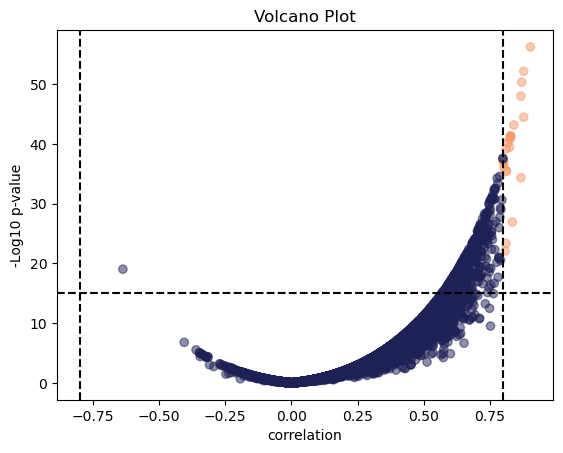

In [188]:
# Define cutoffs for significant differentially expressed genes
pvalue_cutoff = 1e-15
logfc_cutoff = 0.8

# Create a new column to label genes that meet the cutoffs as significant
dat_differential['Significant'] = ((dat_differential['pvalue'] < pvalue_cutoff) & (abs(dat_differential['correlation']) > logfc_cutoff)).map({True:'Yes', False:'No'})

# Make e-value a float
#dat_differential['e-value'] = dat_differential['e-value'].astype(float)

# Create volcano plot
plt.scatter(dat_differential['correlation'], -1 * pd.np.log10(dat_differential['pvalue']), c=dat_differential['Significant'].map({'Yes': '#F39B6A', 'No': '#1E2156',}), alpha=0.5)
plt.xlabel('correlation')
plt.ylabel('-Log10 p-value')
plt.title('Volcano Plot')
plt.axvline(x=-1 * logfc_cutoff, color='black', linestyle='--')
plt.axvline(x=logfc_cutoff, color='black', linestyle='--')
plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')
plt.savefig('../rerun_meme_mast/Vulcanoplot_differential.pdf')
plt.show()

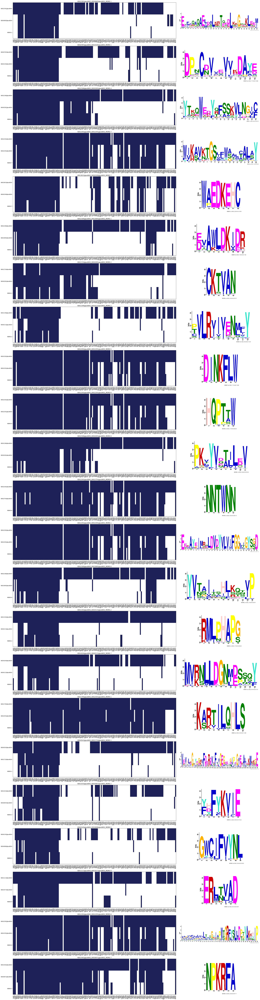

In [189]:
dt_differential=dat_differential.loc[dat_differential['Significant'] == 'Yes']
#dt.to_csv('chi_square_mast-8_Jefferys_prior_significant_Leca_manual.csv')
list_of_interst_differential= dt_differential.index
len(list_of_interst_differential)
present_absent_motif_list_logo(list_of_interst_differential,'LECA_profiles_pearson_differential','differential')

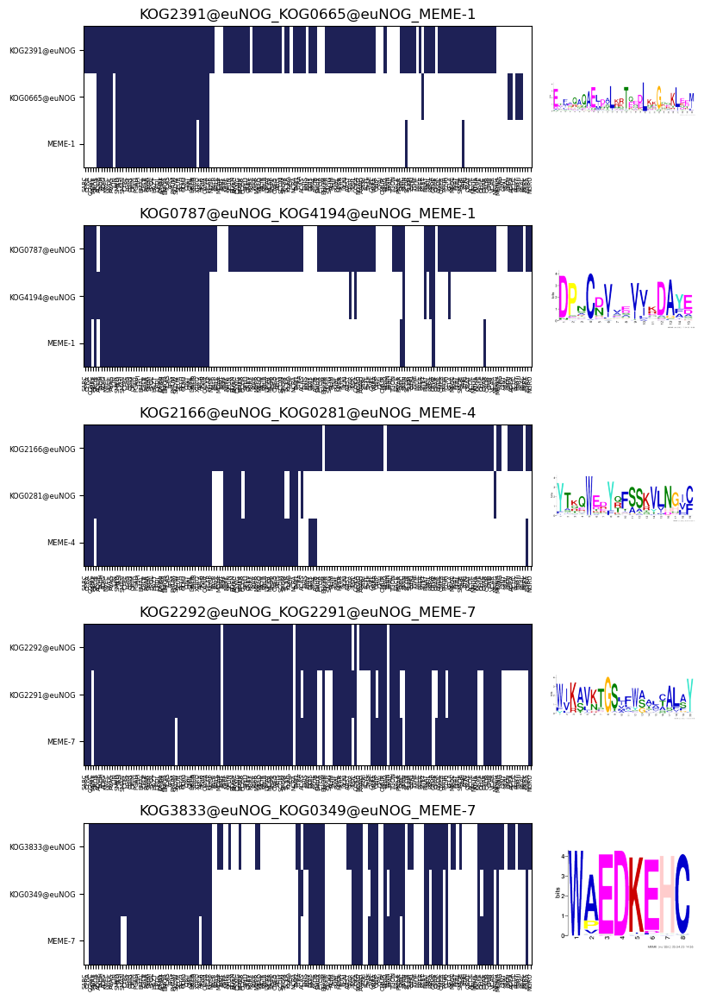

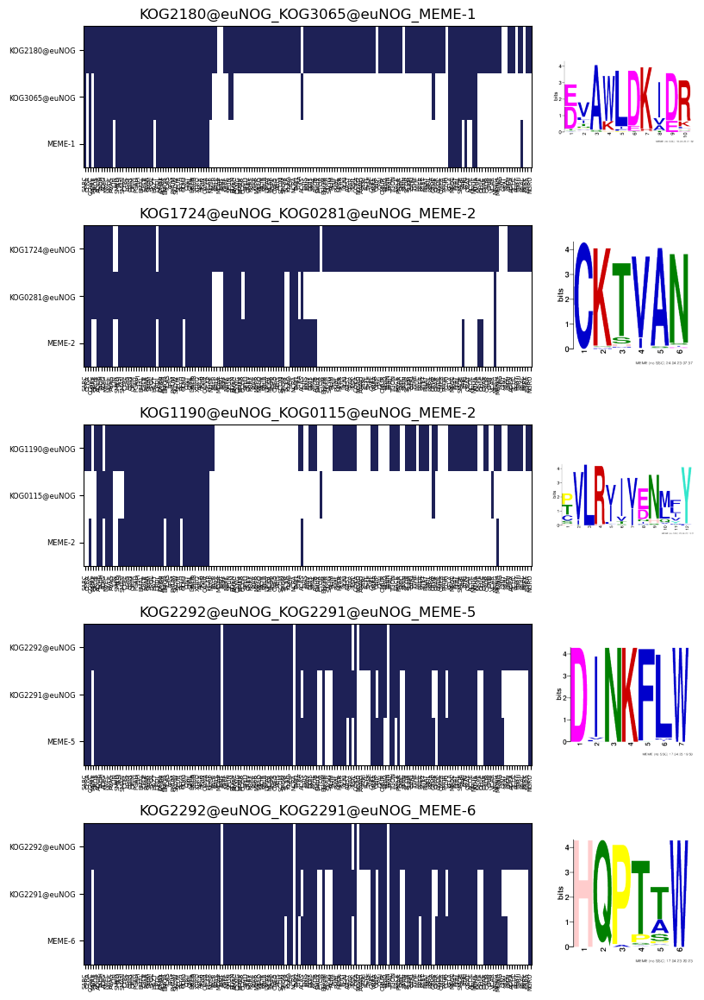

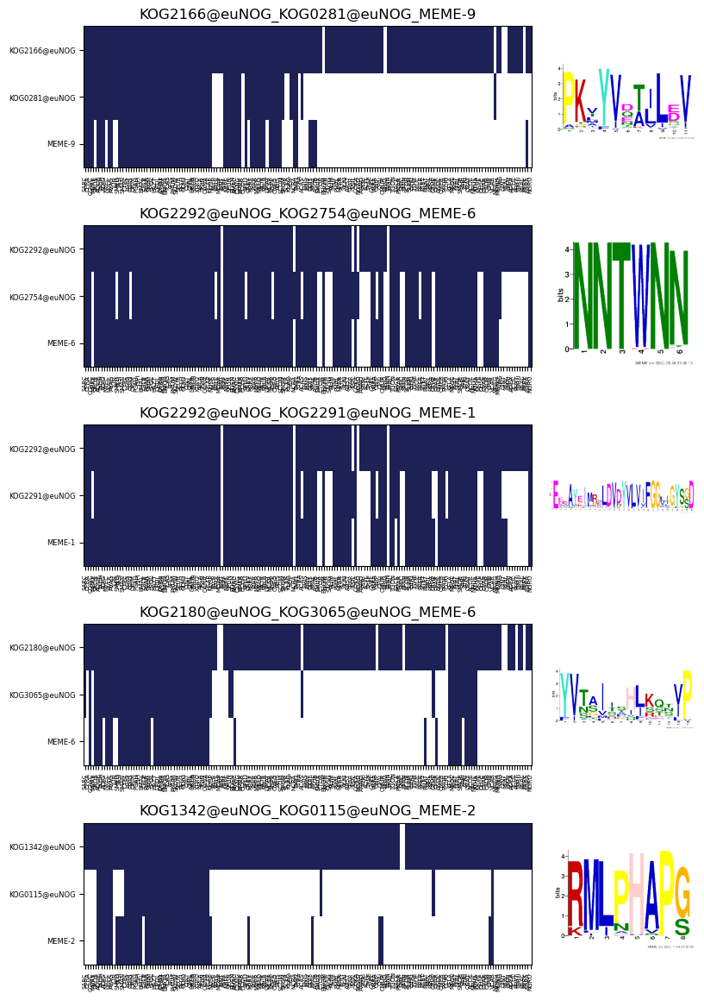

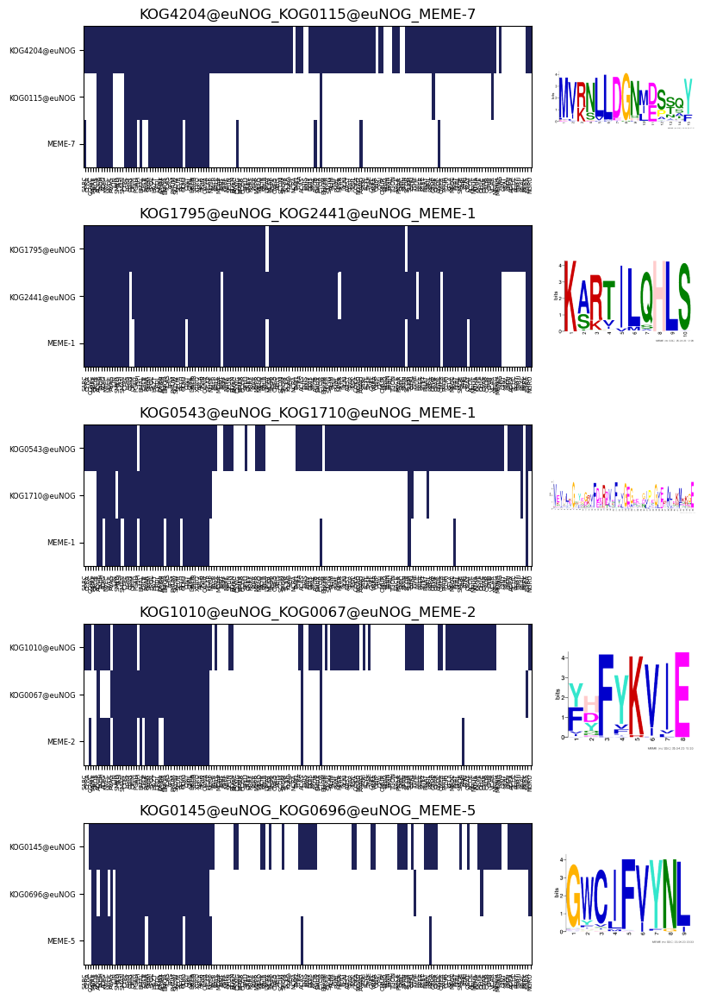

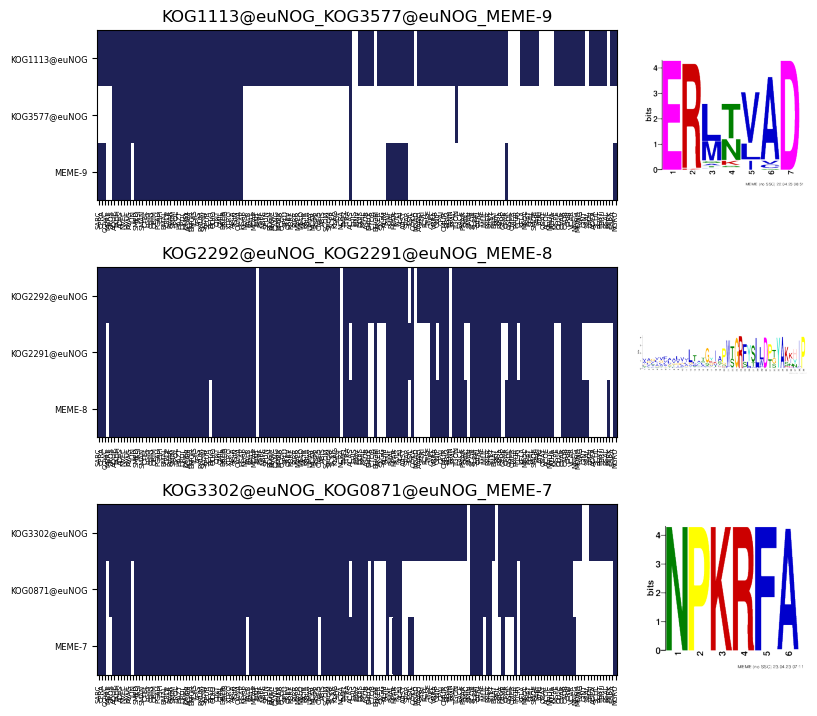

In [396]:
present_absent_motif_list_logo_pages(list_of_interst_differential,'LECA_profiles_pearson_differential_pages','differential')

/tmp/ipykernel_1601268/1320612419.py:12: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.scatter(dat_discrimtaive['correlation'], -1 * pd.np.log10(dat_discrimtaive['pvalue']), c=dat_discrimtaive['Significant'].map({'Yes': '#F39B6A', 'No': '#1E2156',}), alpha=0.5)
/tmp/ipykernel_1601268/1320612419.py:18: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')


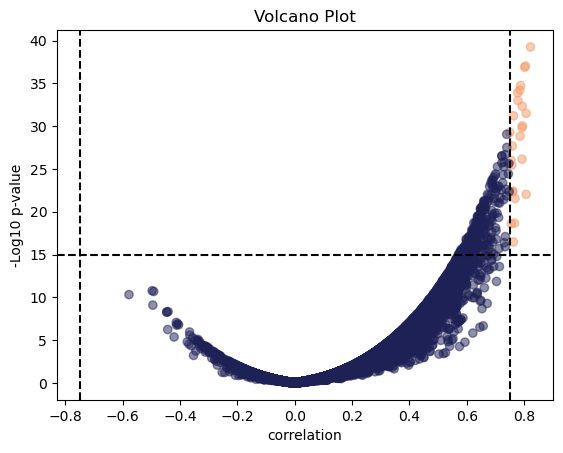

In [190]:
# Define cutoffs for significant differentially expressed genes
pvalue_cutoff = 1e-15
logfc_cutoff = 0.75

# Create a new column to label genes that meet the cutoffs as significant
dat_discrimtaive['Significant'] = ((dat_discrimtaive['pvalue'] < pvalue_cutoff) & (abs(dat_discrimtaive['correlation']) > logfc_cutoff)).map({True:'Yes', False:'No'})

# Make e-value a float
#dat_differential['e-value'] = dat_differential['e-value'].astype(float)

# Create volcano plot
plt.scatter(dat_discrimtaive['correlation'], -1 * pd.np.log10(dat_discrimtaive['pvalue']), c=dat_discrimtaive['Significant'].map({'Yes': '#F39B6A', 'No': '#1E2156',}), alpha=0.5)
plt.xlabel('correlation')
plt.ylabel('-Log10 p-value')
plt.title('Volcano Plot')
plt.axvline(x=-1 * logfc_cutoff, color='black', linestyle='--')
plt.axvline(x=logfc_cutoff, color='black', linestyle='--')
plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')
plt.savefig('../rerun_meme_mast/Vulcanoplot_discrimtaive.pdf')
plt.show()

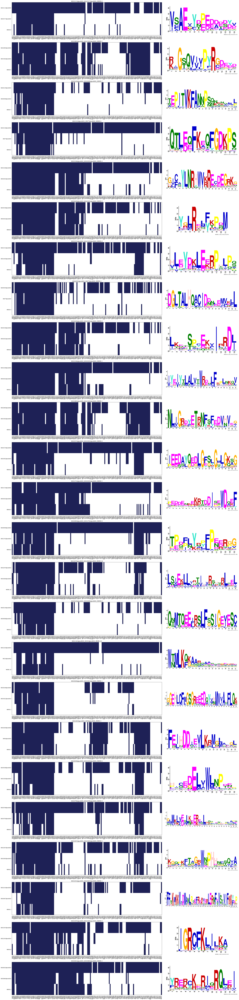

In [268]:
dt_discrimtaive=dat_discrimtaive.loc[dat_discrimtaive['Significant'] == 'Yes']
#dt.to_csv('chi_square_mast-8_Jefferys_prior_significant_Leca_manual.csv')
list_of_interst_discrimtaive= dt_discrimtaive.index
len(list_of_interst_discrimtaive)
present_absent_motif_list_logo(list_of_interst_discrimtaive,'LECA_profiles_pearson_discrimtaive','discrimative')

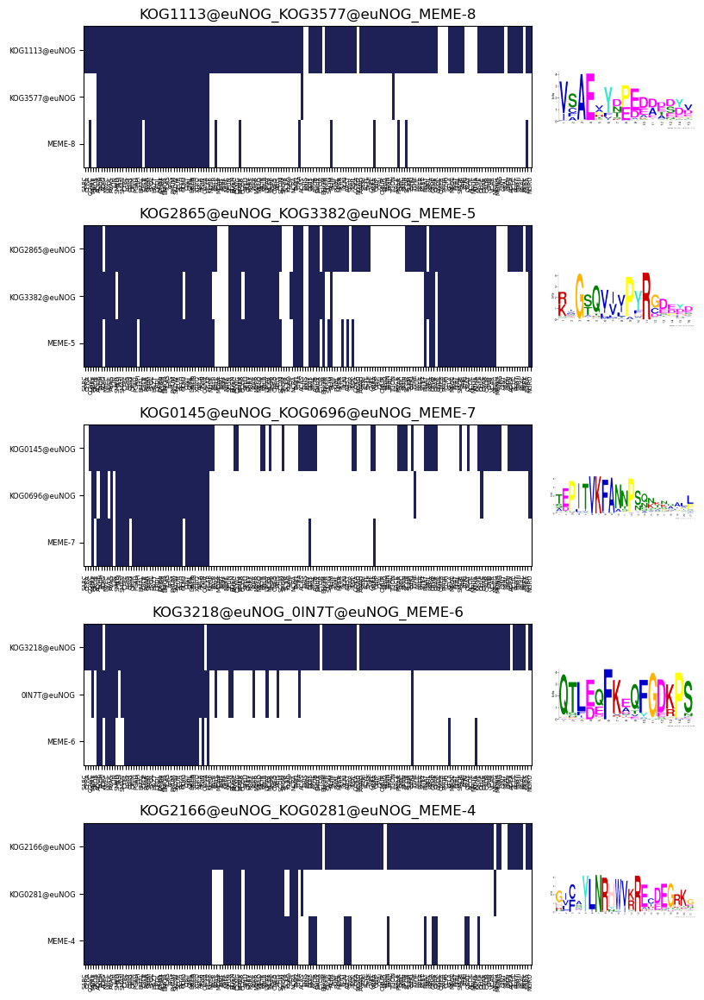

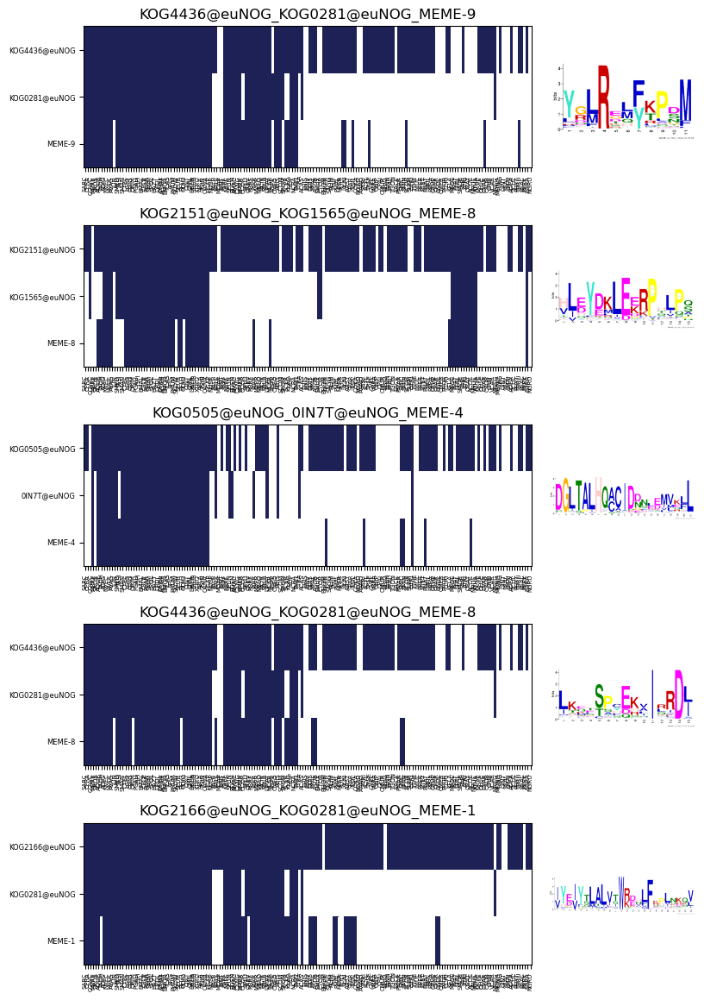

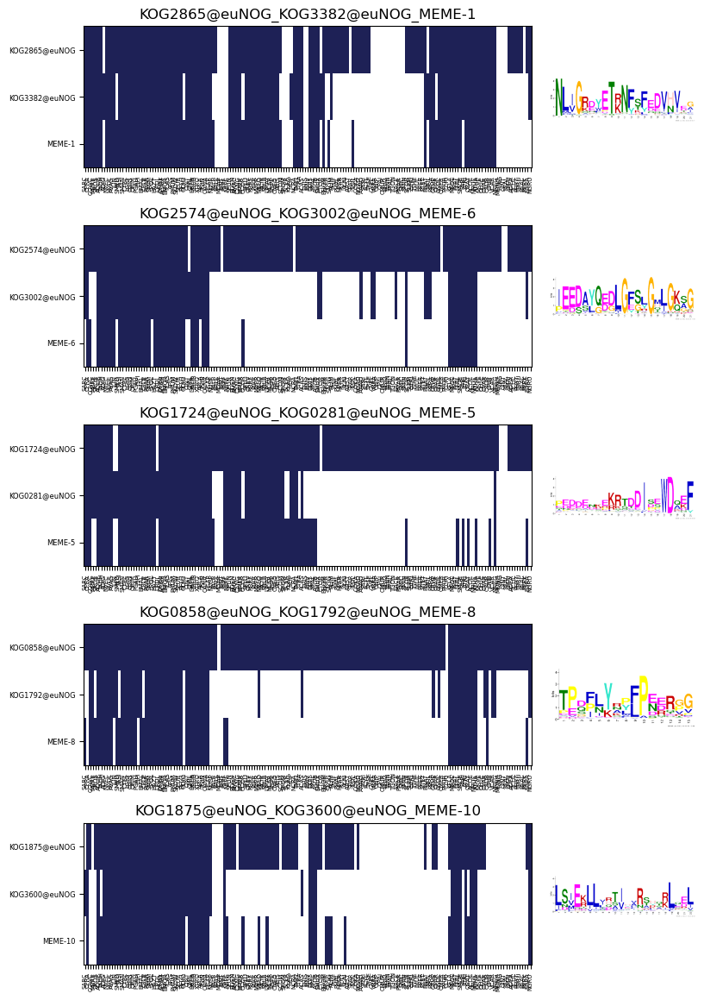

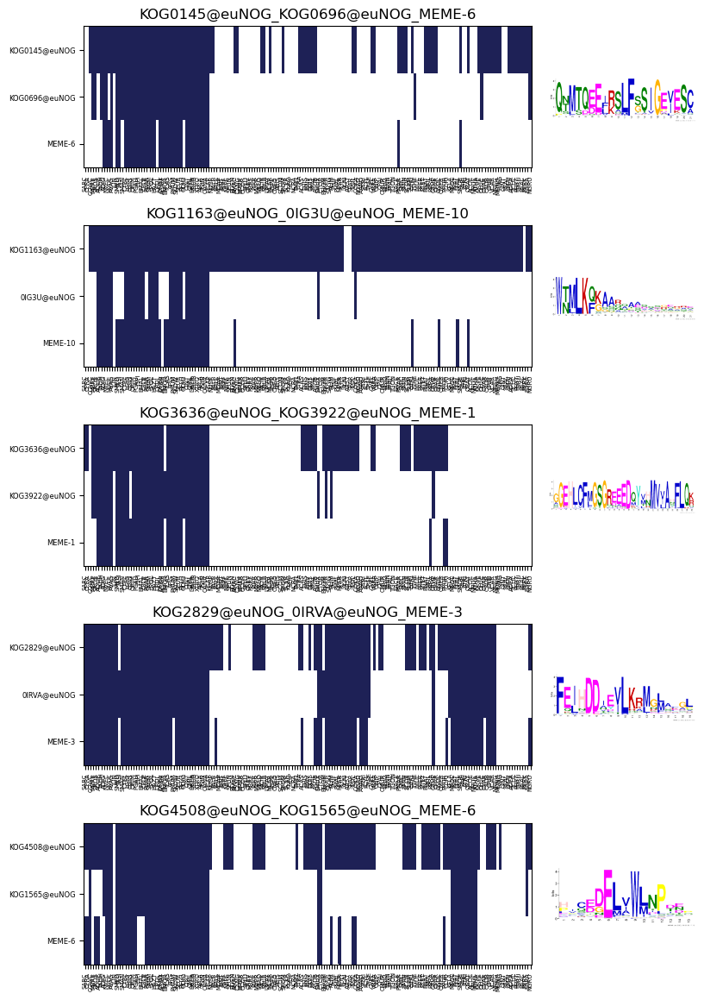

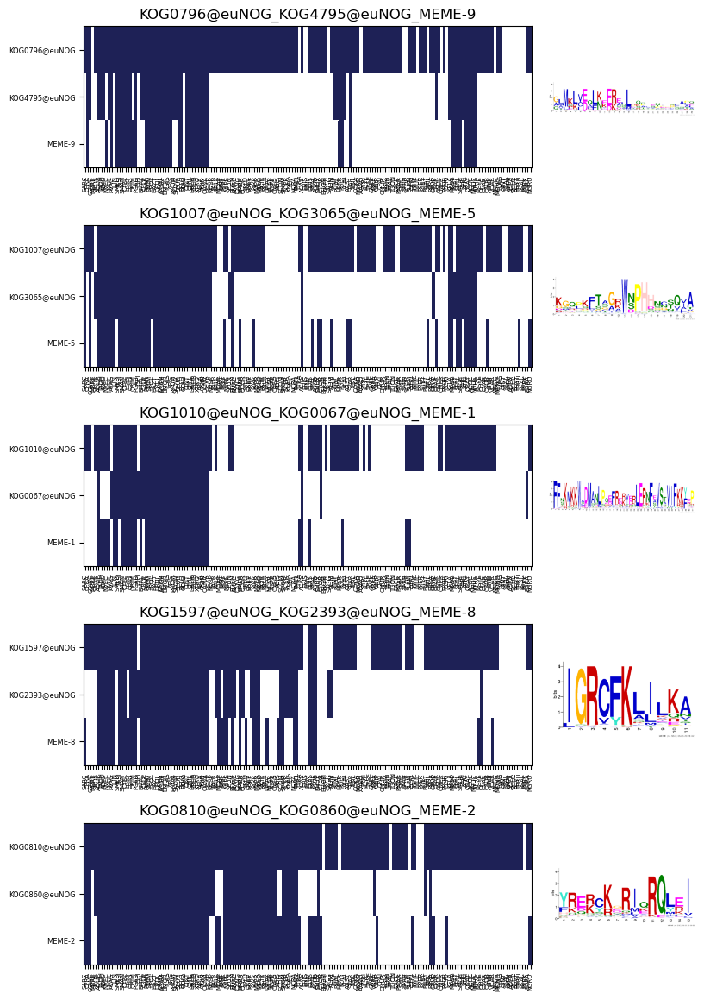

In [395]:
present_absent_motif_list_logo_pages(list_of_interst_discrimtaive,'LECA_profiles_pearson_discrimtaive_pages','discrimative')

Classic

/tmp/ipykernel_1601268/3825526673.py:12: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.scatter(dat_classic['correlation'], -1 * pd.np.log10(dat_classic['pvalue']), c=dat_classic['Significant'].map({'Yes': '#F39B6A', 'No': '#1E2156',}), alpha=0.5)
/tmp/ipykernel_1601268/3825526673.py:18: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')


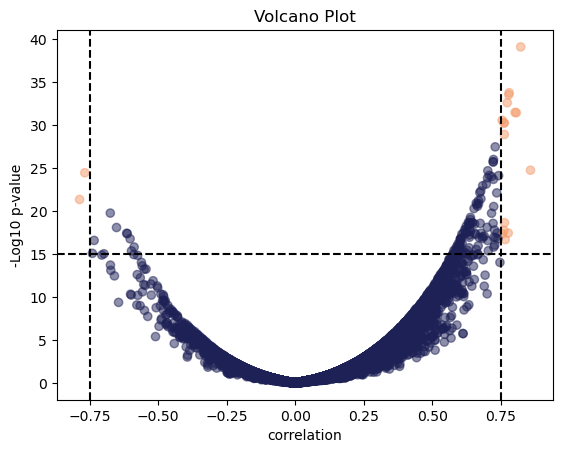

In [103]:
# Define cutoffs for significant differentially expressed genes
pvalue_cutoff = 1e-15
logfc_cutoff = 0.75

# Create a new column to label genes that meet the cutoffs as significant
dat_classic['Significant'] = ((dat_classic['pvalue'] < pvalue_cutoff) & (abs(dat_classic['correlation']) > logfc_cutoff)).map({True:'Yes', False:'No'})

# Make e-value a float
#dat_differential['e-value'] = dat_differential['e-value'].astype(float)

# Create volcano plot
plt.scatter(dat_classic['correlation'], -1 * pd.np.log10(dat_classic['pvalue']), c=dat_classic['Significant'].map({'Yes': '#F39B6A', 'No': '#1E2156',}), alpha=0.5)
plt.xlabel('correlation')
plt.ylabel('-Log10 p-value')
plt.title('Volcano Plot')
plt.axvline(x=-1 * logfc_cutoff, color='black', linestyle='--')
plt.axvline(x=logfc_cutoff, color='black', linestyle='--')
plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')
plt.savefig('../rerun_meme_mast/Vulcanoplot_classic.pdf')
plt.show()

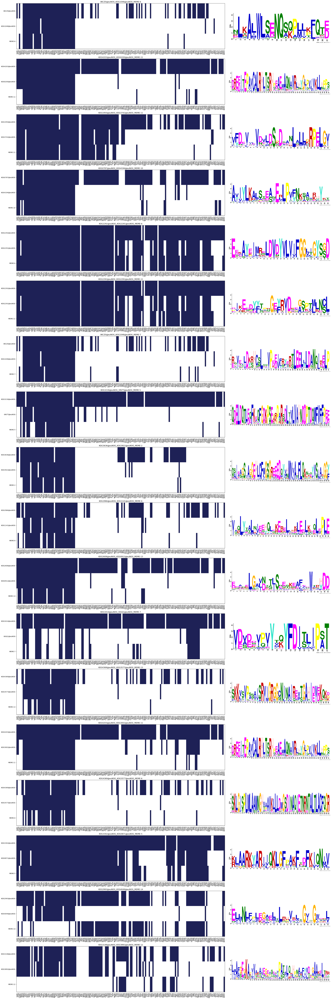

In [104]:
dt_classic=dat_classic.loc[dat_classic['Significant'] == 'Yes']
#dt.to_csv('chi_square_mast-8_Jefferys_prior_significant_Leca_manual.csv')
list_of_interst_classic= dt_classic.index
len(list_of_interst_classic)
present_absent_motif_list_logo(list_of_interst_classic,'LECA_profiles_pearson_classic_scann','classic')

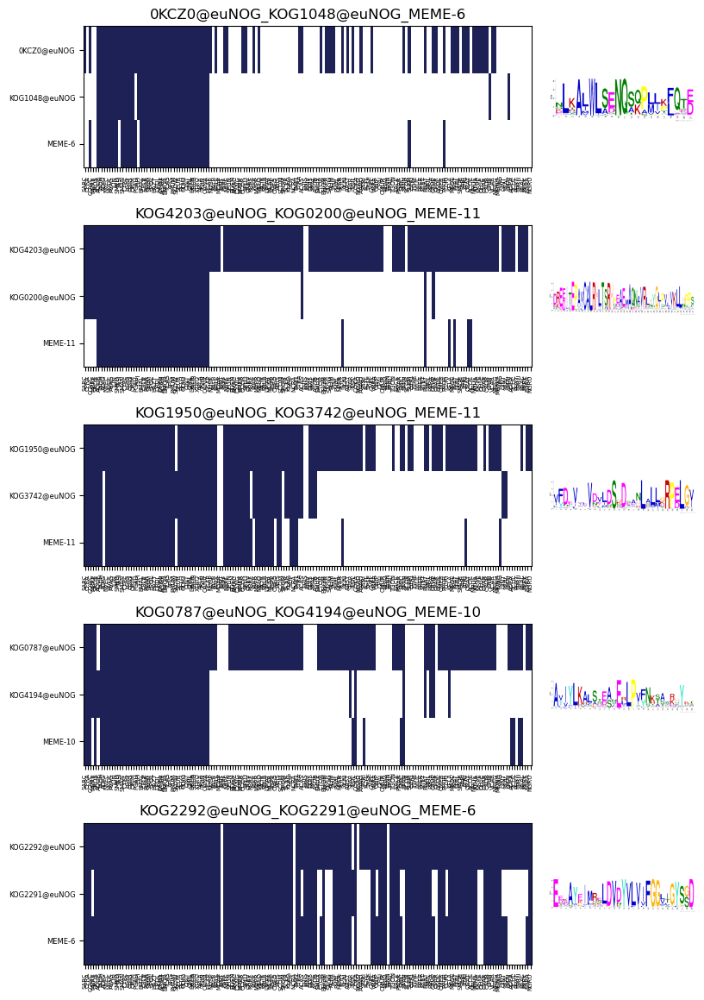

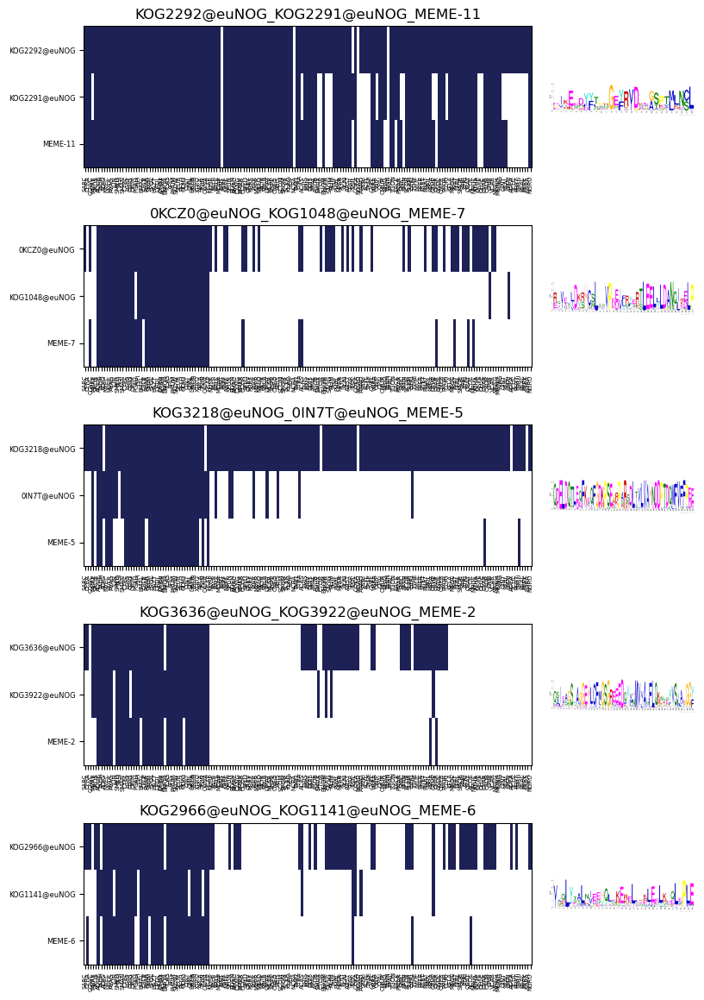

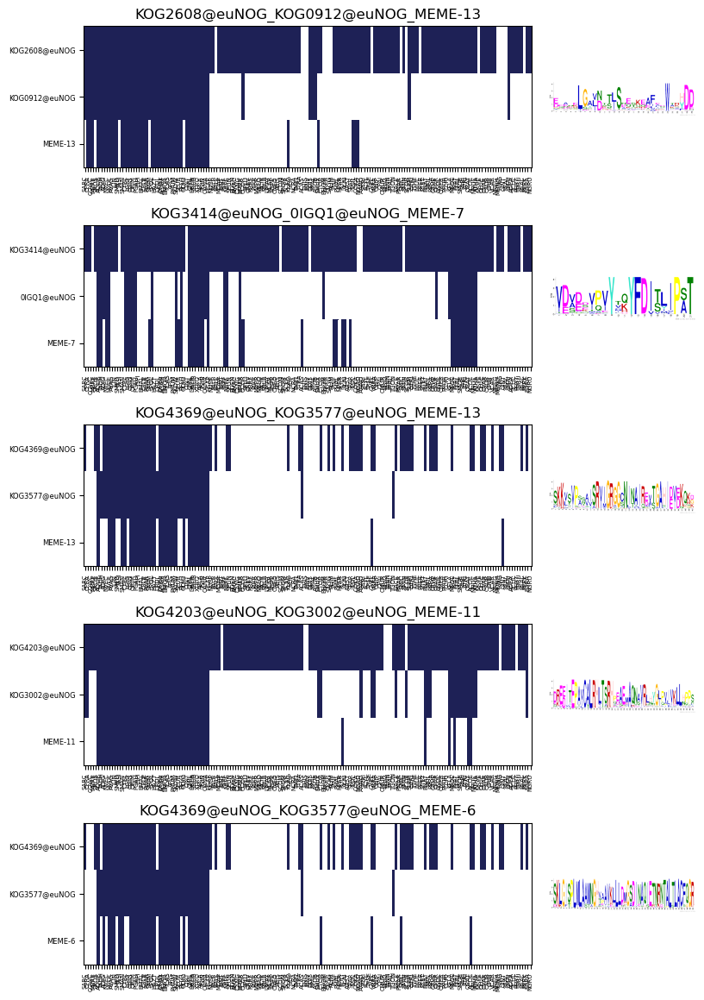

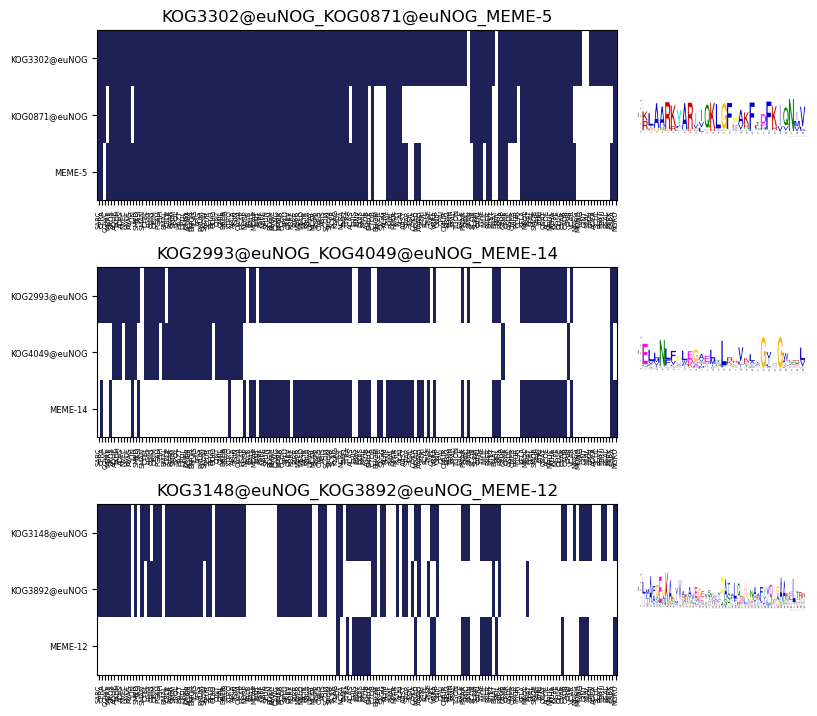

In [394]:
present_absent_motif_list_logo_pages(list_of_interst_classic,'LECA_profiles_pearson_classic_scann_pages','classic')

# Add Manual information

In [52]:
interaction = {'cdc20_mad2': 'a+a++a++++-+-+++++++-+b+b++++++++++++b++++++++++-+--++++--+-b++b++++b++++++bb+b+++--+++++++++++b++++++b++++b----------aa+aaa---+b++++++-++++++++++++++++++b-bbbbb-b--++', 
               'mad1_mad2': 'a+ab+-++++-b-+++++++-bb++++++++++++++b++++++++++-b--++++a-+-++++++bb+b++++++++++++--+++bb+++++b+++++++bb+++b------------b------+b+b++++a+++++++++++b++b+b+b-bbbbb-b--+b', 
               'dsn1_csm1': '++aaabbb+b-----a---a-----a----------a--aaaaaa-a+-+abaa+++-+++++a+++++bb++++aa+++aa--+bb-b-+++++++b+++ba-aa--------------b------bb+aa++b-ab-b--bbbbb++b++++-b----------a', 
               'cenpc_mis12': 'b++a++++ba-a--b+++b+b++-++bbb--bb-++a-a++bb+++++-+ab+++++a+++++b++bb+++++++++++b-+--bbb++-+-+++++a++++--+aaa+-aa--a--a++a------++++b++aa+++++++++++++a+a++a+---------b+'}
profiles |=interaction

In [85]:
database_protein = {}
database_protein['mad1'] = SeqIO.to_dict(SeqIO.parse('../Manual_orhtologs_groups/mad1_adjusted.fa',  "fasta"))
database_protein['mad2'] = SeqIO.to_dict(SeqIO.parse('../Manual_orhtologs_groups/mad2_adjusted.fa',  "fasta"))
database_protein['cdc20'] = SeqIO.to_dict(SeqIO.parse('../Manual_orhtologs_groups/cdc20_adjusted.fa',  "fasta"))
database_protein['cenpc'] = SeqIO.to_dict(SeqIO.parse('../Manual_orhtologs_groups/cenpc_adjusted.fa',  "fasta"))
database_protein['csm1'] = SeqIO.to_dict(SeqIO.parse('../Manual_orhtologs_groups/csm1_adjusted.fa',  "fasta"))
database_protein['dsn1'] = SeqIO.to_dict(SeqIO.parse('../Manual_orhtologs_groups/dsn1_adjusted.fa',  "fasta"))
database_protein['mis12'] = SeqIO.to_dict(SeqIO.parse('../Manual_orhtologs_groups/mis12_adjusted.fa',  "fasta"))

for line in database_protein:
    profile_vectors = [0]*len(Speciesorder)
    for i, species in enumerate(Speciesorder):
        species_key = next((key for key in database_protein[line].keys() if key.startswith(species)), None)
        if species_key is not None:
            profile_vectors[i] = 1
    egg_corrected_profiles[line] = profile_vectors

differential meme

In [86]:
Direc = '../Manual_orhtologs_groups/Meme_run/'
entries = os.listdir(Direc)
list_of_interst=[]
for dirt in entries:
    dic_chi_square = {}
    with cd(Direc+dirt):
        try:
            with open('meme.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))
                meme_motif = {}
                for l in range(len(meme_json["motifs"])):
                    meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"]
                    
            with open('mast_out/mast.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))

                mast_out = {}
                db_motif = {}
                for l in range(len(meme_json["motifs"])):
                    db_motif[l]=meme_json["motifs"][l]['alt']
                for i in range(len(meme_json['sequences'])):
                    if meme_json['sequences'][i]['name'][:4] not in mast_out:
                        mast_out[meme_json['sequences'][i]['name'][:4]]=[]
                    if 'segs' in meme_json['sequences'][i]:
                        for j in range(len(meme_json['sequences'][i]['segs'])):
                            for m in meme_json['sequences'][i]['segs'][j]['hits']:
                                if m['idx'] not in mast_out[meme_json['sequences'][i]['name'][:4]]:
 #                                   if m['pvalue']<1e-5:
                                        mast_out[meme_json['sequences'][i]['name'][:4]]+= [db_motif[m['idx']]]

                motifs ={}
                for i in mast_out:
                    for j in mast_out[i]:
                        if j not in motifs:
                            motifs[j]=[]
                        if i not in motifs[j]:
                            motifs[j]+= [i]
                motifs_pa['differential'][dirt]=motifs
                
                for motif in motifs:
                    dic_chi_square[motif]= []
                    b=[]
                    m=[]
                    for index, value in enumerate(profiles[dirt]):
                        if value == '+' and Speciesorder[index] in motifs[motif]:
                            b.append(1)
                            m.append(1)
                        if value == '+' and Speciesorder[index] not in motifs[motif]:
                            b.append(1)
                            m.append(0)
                        if value == 'a' and Speciesorder[index] in motifs[motif]:
                            b.append(0)
                            m.append(1)
                        if value == 'a' and Speciesorder[index] not in motifs[motif]:
                            b.append(0)
                            m.append(0)
                    
                    if len(b)==b.count(0) or len(b)==b.count(1):
                        if b[0] == 1:
                            b.append(0)
                            m.append(0)
                        if b[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'b')

                    if len(m)==m.count(0) or len(m)==m.count(1):
                        if m[0] == 1:
                            b.append(0)
                            m.append(0)
                        if m[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'm') 
                    r,p = pearsonr(b,m)
                    dic_chi_square[motif]=[r,p]
                    list_of_interst+=[dirt+'_'+motif]
        except:
            print(dirt)

    motifs_ents['differential'][dirt]=dic_chi_square       

Every position in the list has the same value: cdc20_mad2 MEME-7 m


In [87]:
Leca_manual_differential=list(LECA_motif_differential)+list(list_of_interst)

#create Dictionary and save
new_dic = {}
for eggs in motifs_ents['differential']:
    p = eggs.split('_')
    for mots in motifs_ents['differential'][eggs]:
        new_dic[eggs+'_'+str(mots)] = motifs_ents['differential'][eggs][mots]
        
for i in Leca_manual_differential:
    leca_dic_differential[i]= new_dic[i]

dat_differential = pd.DataFrame.from_dict(leca_dic_differential, orient='index',columns=['correlation','pvalue'])
dat_differential = dat_differential.sort_values(by=['correlation'], ascending=False)
dat_differential.head(20)

dat_differential.to_csv('../pearson_corrolation_differntial_manual.csv')

/tmp/ipykernel_1450994/954903457.py:41: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')


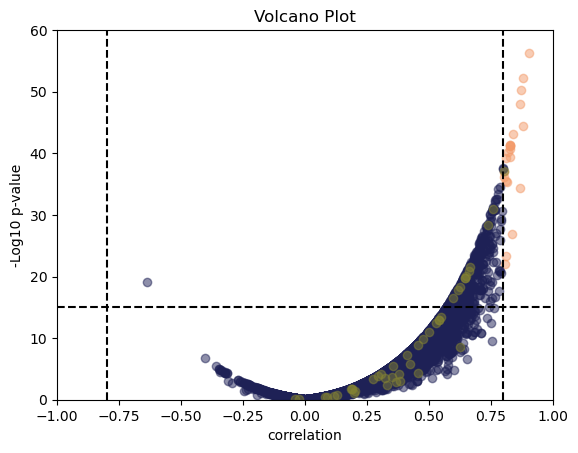

In [95]:
# Define cutoffs for significant differentially expressed genes
pvalue_cutoff = 1e-15
logfc_cutoff = 0.8
manual_ogs= list(interaction.keys())


# Create a new column to label genes that meet the cutoffs as significant
dat_differential['Significant'] = ((dat_differential['pvalue'] < pvalue_cutoff) & (abs(dat_differential['correlation']) > logfc_cutoff)).map({True:'Yes', False:'No'})
for i, row in dat_differential.iterrows():
    if i.startswith(tuple(manual_ogs)):
        dat_differential.at[i,'Significant']= 'Manual'
for i, row in dat_differential.iterrows():
    if i.startswith('KOG3302@euNOG_KOG0871@euNOG'):
        dat_differential.at[i,'Significant']= 'Manual'
for i, row in dat_differential.iterrows():
    if i.startswith('KOG3302@euNOG_KOG0392@euNOG'):
        dat_differential.at[i,'Significant']= 'Manual'
for i, row in dat_differential.iterrows():
    if i.startswith('KOG3302@euNOG_KOG1659@euNOG'):
        dat_differential.at[i,'Significant']= 'Manual'
    

# Create volcano plot
# Create a volcano plot
plt.scatter(dat_differential[dat_differential['Significant'] == 'Yes']['correlation'],
            -1 * np.log10(dat_differential[dat_differential['Significant'] == 'Yes']['pvalue']),
            c='#F39B6A', label='Yes', alpha=0.5)

plt.scatter(dat_differential[dat_differential['Significant'] == 'No']['correlation'],
            -1 * np.log10(dat_differential[dat_differential['Significant'] == 'No']['pvalue']),
            c='#1E2156', label='No', alpha=0.5)

plt.scatter(dat_differential[dat_differential['Significant'] == 'Manual']['correlation'],
            -1 * np.log10(dat_differential[dat_differential['Significant'] == 'Manual']['pvalue']),
            c='#838233', label='Manual', alpha=0.5)
plt.xlabel('correlation')
plt.ylabel('-Log10 p-value')
plt.title('Volcano Plot')
plt.axvline(x=-1 * logfc_cutoff, color='black', linestyle='--')
plt.axvline(x=logfc_cutoff, color='black', linestyle='--')
plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')
plt.xlim(-1, 1)
plt.ylim(0, 60)
plt.savefig('../rerun_meme_mast/Vulcanoplot_differential_manual.pdf')
plt.show()

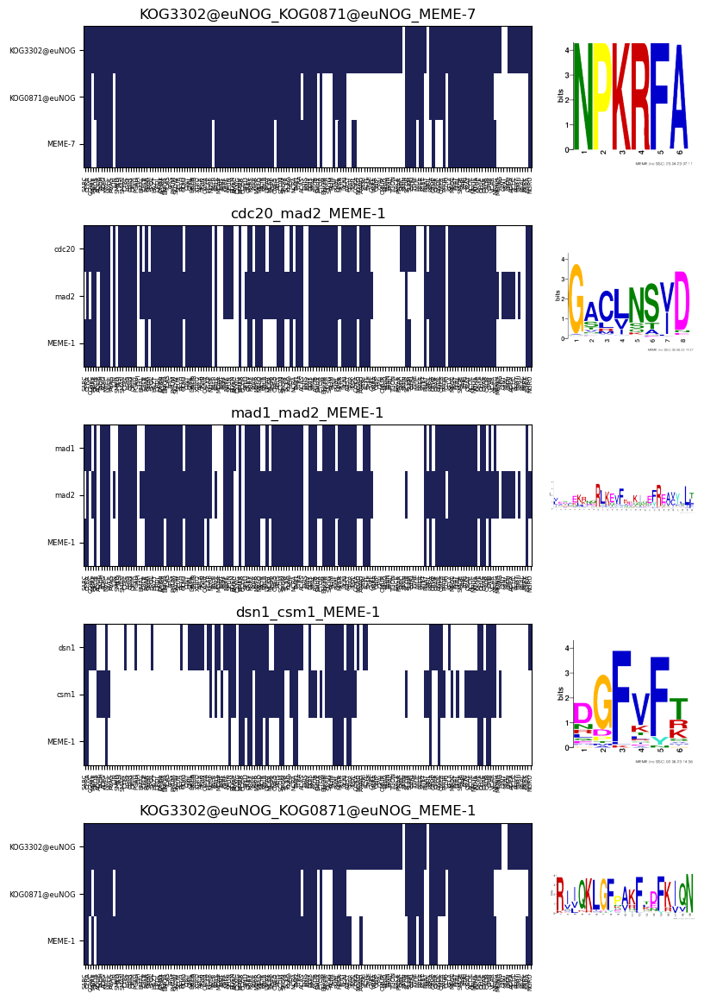

In [393]:
filtered_df = dat_differential[dat_differential['Significant'] == 'Manual']
list_output=[]
for i, row in filtered_df.iterrows():
    list_output+=[i]
list_of_interst = ['KOG3302@euNOG_KOG0871@euNOG_MEME-7','cdc20_mad2_MEME-1','mad1_mad2_MEME-1','dsn1_csm1_MEME-1','KOG3302@euNOG_KOG0871@euNOG_MEME-1']
present_absent_motif_list_logo_pages(list_of_interst,'LECA_profiles_pearson_differential_pages_Manual','differential')

Do the same thing for discrimative mode

In [89]:
Direc = '../Manual_orhtologs_groups/discordant_motifs/'
entries = os.listdir(Direc)
list_of_interst=[]
for dirt in entries:
    dic_chi_square = {}
    with cd(Direc+dirt):
        try:
            with open('meme.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))
                meme_motif = {}
                for l in range(len(meme_json["motifs"])):
                    meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"]
                    
            with open('mast_out/mast.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))

                mast_out = {}
                db_motif = {}
                for l in range(len(meme_json["motifs"])):
                    db_motif[l]=meme_json["motifs"][l]['alt']
                for i in range(len(meme_json['sequences'])):
                    if meme_json['sequences'][i]['name'][:4] not in mast_out:
                        mast_out[meme_json['sequences'][i]['name'][:4]]=[]
                    if 'segs' in meme_json['sequences'][i]:
                        for j in range(len(meme_json['sequences'][i]['segs'])):
                            for m in meme_json['sequences'][i]['segs'][j]['hits']:
                                if m['idx'] not in mast_out[meme_json['sequences'][i]['name'][:4]]:
 #                                   if m['pvalue']<1e-5:
                                        mast_out[meme_json['sequences'][i]['name'][:4]]+= [db_motif[m['idx']]]

                motifs ={}
                for i in mast_out:
                    for j in mast_out[i]:
                        if j not in motifs:
                            motifs[j]=[]
                        if i not in motifs[j]:
                            motifs[j]+= [i]
                motifs_pa['discrimative'][dirt]=motifs
                
                for motif in motifs:
                    dic_chi_square[motif]= []
                    b=[]
                    m=[]
                    for index, value in enumerate(profiles[dirt]):
                        if value == '+' and Speciesorder[index] in motifs[motif]:
                            b.append(1)
                            m.append(1)
                        if value == '+' and Speciesorder[index] not in motifs[motif]:
                            b.append(1)
                            m.append(0)
                        if value == 'a' and Speciesorder[index] in motifs[motif]:
                            b.append(0)
                            m.append(1)
                        if value == 'a' and Speciesorder[index] not in motifs[motif]:
                            b.append(0)
                            m.append(0)
                    
                    if len(b)==b.count(0) or len(b)==b.count(1):
                        if b[0] == 1:
                            b.append(0)
                            m.append(0)
                        if b[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'b')

                    if len(m)==m.count(0) or len(m)==m.count(1):
                        if m[0] == 1:
                            b.append(0)
                            m.append(0)
                        if m[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'm') 
                    r,p = pearsonr(b,m)
                    dic_chi_square[motif]=[r,p]
                    list_of_interst+=[dirt+'_'+motif]
        except:
            print(dirt)

    motifs_ents['discrimative'][dirt]=dic_chi_square  
    
Leca_manual_discrimative=list(LECA_motif_discrimative)+list(list_of_interst)

#create Dictionary and save
new_dic = {}
for eggs in motifs_ents['discrimative']:
    p = eggs.split('_')
    for mots in motifs_ents['discrimative'][eggs]:
        new_dic[eggs+'_'+str(mots)] = motifs_ents['discrimative'][eggs][mots]
        
for i in Leca_manual_discrimative:
    leca_dic_discrimative[i]= new_dic[i]

dat_discrimative = pd.DataFrame.from_dict(leca_dic_discrimative, orient='index',columns=['correlation','pvalue'])
dat_discrimative = dat_discrimative.sort_values(by=['correlation'], ascending=False)
dat_discrimative.head(20)

dat_discrimative.to_csv('../pearson_corrolation_discrimative_manual.csv')

Every position in the list has the same value: cdc20_mad2 MEME-7 m
Every position in the list has the same value: cdc20_mad2 MEME-6 m
Every position in the list has the same value: cdc20_mad2 MEME-4 m


In [403]:
print(b)

[1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0]


/tmp/ipykernel_1450994/988067074.py:41: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')


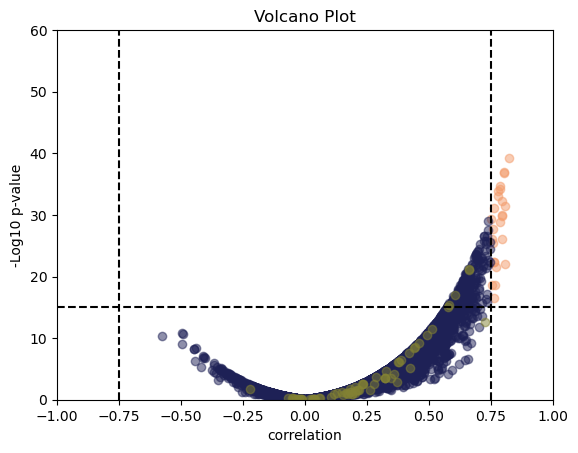

In [96]:
# Define cutoffs for significant differentially expressed genes
pvalue_cutoff = 1e-15
logfc_cutoff = 0.75
manual_ogs= list(interaction.keys())


# Create a new column to label genes that meet the cutoffs as significant
dat_discrimative['Significant'] = ((dat_discrimative['pvalue'] < pvalue_cutoff) & (abs(dat_discrimative['correlation']) > logfc_cutoff)).map({True:'Yes', False:'No'})
for i, row in dat_discrimative.iterrows():
    if i.startswith(tuple(manual_ogs)):
        dat_discrimative.at[i,'Significant']= 'Manual'
for i, row in dat_discrimative.iterrows():
    if i.startswith('KOG3302@euNOG_KOG0871@euNOG'):
        dat_discrimative.at[i,'Significant']= 'Manual'
for i, row in dat_discrimative.iterrows():
    if i.startswith('KOG3302@euNOG_KOG0392@euNOG'):
        dat_discrimative.at[i,'Significant']= 'Manual'
for i, row in dat_discrimative.iterrows():
    if i.startswith('KOG3302@euNOG_KOG1659@euNOG'):
        dat_discrimative.at[i,'Significant']= 'Manual'
     


# Create a volcano plot
plt.scatter(dat_discrimative[dat_discrimative['Significant'] == 'Yes']['correlation'],
            -1 * np.log10(dat_discrimative[dat_discrimative['Significant'] == 'Yes']['pvalue']),
            c='#F39B6A', label='Yes', alpha=0.5)

plt.scatter(dat_discrimative[dat_discrimative['Significant'] == 'No']['correlation'],
            -1 * np.log10(dat_discrimative[dat_discrimative['Significant'] == 'No']['pvalue']),
            c='#1E2156', label='No', alpha=0.5)

plt.scatter(dat_discrimative[dat_discrimative['Significant'] == 'Manual']['correlation'],
            -1 * np.log10(dat_discrimative[dat_discrimative['Significant'] == 'Manual']['pvalue']),
            c='#838233', label='Manual', alpha=0.5)
plt.xlabel('correlation')
plt.ylabel('-Log10 p-value')
plt.title('Volcano Plot')
plt.axvline(x=-1 * logfc_cutoff, color='black', linestyle='--')
plt.axvline(x=logfc_cutoff, color='black', linestyle='--')
plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')
plt.xlim(-1, 1)
plt.ylim(0, 60)
plt.savefig('../rerun_meme_mast/Vulcanoplot_discrimative_manual.pdf')
plt.show()

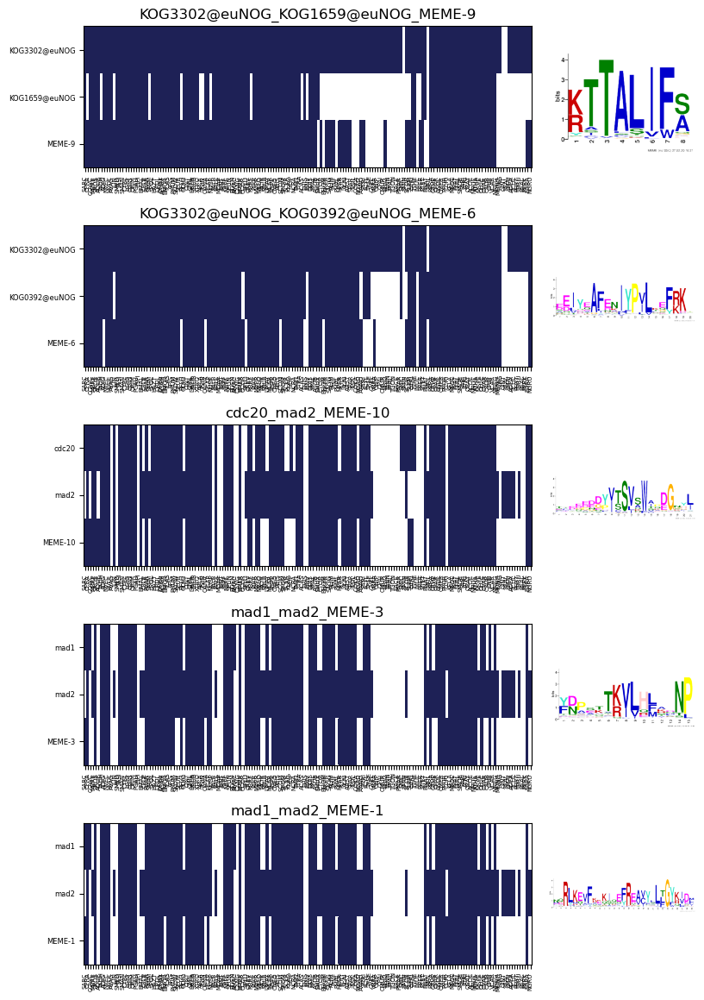

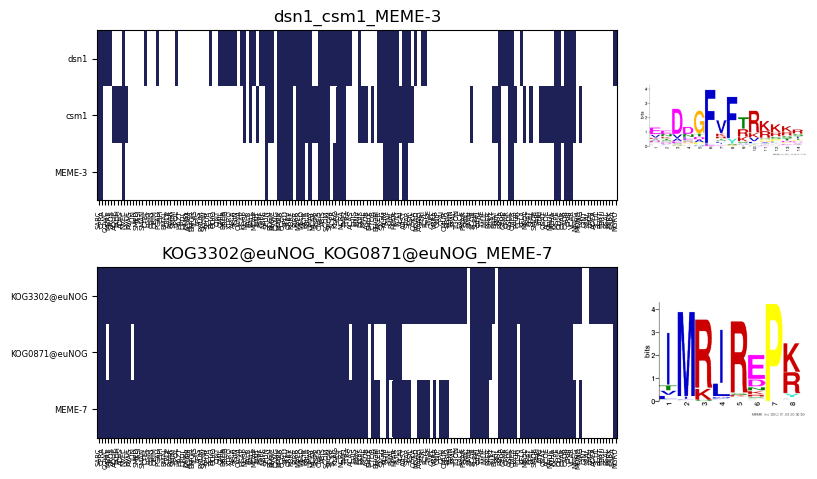

In [92]:
filtered_df = dat_discrimative[dat_discrimative['Significant'] == 'Manual']
list_output=[]
for i, row in filtered_df.iterrows():
    list_output+=[i]
#print(sorted(list_output))
list_of_interst = ['KOG3302@euNOG_KOG1659@euNOG_MEME-9','KOG3302@euNOG_KOG0392@euNOG_MEME-6','cdc20_mad2_MEME-10','mad1_mad2_MEME-3','mad1_mad2_MEME-1','dsn1_csm1_MEME-3','KOG3302@euNOG_KOG0871@euNOG_MEME-7']
present_absent_motif_list_logo_pages(list_of_interst,'LECA_profiles_pearson_discrimative_pages_Manual','discrimative')

And for classic meme

In [93]:
Direc = '../Manual_orhtologs_groups/Classic_meme/'
entries = os.listdir(Direc)
list_of_interst=[]
for dirt in entries:
    dic_chi_square = {}
    with cd(Direc+dirt):
    #    try:
            with open('meme.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))
                meme_motif = {}
                for l in range(len(meme_json["motifs"])):
                    meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"]
                    
            with open('mast_out/mast.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))

                mast_out = {}
                db_motif = {}
                for l in range(len(meme_json["motifs"])):
                    db_motif[l]=meme_json["motifs"][l]['alt']
                for i in range(len(meme_json['sequences'])):
                    if meme_json['sequences'][i]['name'][:4] not in mast_out:
                        mast_out[meme_json['sequences'][i]['name'][:4]]=[]
                    if 'segs' in meme_json['sequences'][i]:
                        for j in range(len(meme_json['sequences'][i]['segs'])):
                            for m in meme_json['sequences'][i]['segs'][j]['hits']:
                                if m['idx'] not in mast_out[meme_json['sequences'][i]['name'][:4]]:
 #                                   if m['pvalue']<1e-5:
                                        mast_out[meme_json['sequences'][i]['name'][:4]]+= [db_motif[m['idx']]]

                motifs ={}
                for i in mast_out:
                    for j in mast_out[i]:
                        if j not in motifs:
                            motifs[j]=[]
                        if i not in motifs[j]:
                            motifs[j]+= [i]
                motifs_pa['classic'][dirt]=motifs
                
                for motif in motifs:
                    dic_chi_square[motif]= []
                    b=[]
                    m=[]
                    for index, value in enumerate(profiles[dirt]):
                        if value == '+' and Speciesorder[index] in motifs[motif]:
                            b.append(1)
                            m.append(1)
                        if value == '+' and Speciesorder[index] not in motifs[motif]:
                            b.append(1)
                            m.append(0)
                        if value == 'a' and Speciesorder[index] in motifs[motif]:
                            b.append(0)
                            m.append(1)
                        if value == 'a' and Speciesorder[index] not in motifs[motif]:
                            b.append(0)
                            m.append(0)
                    
                    if len(b)==b.count(0) or len(b)==b.count(1):
                        if b[0] == 1:
                            b.append(0)
                            m.append(0)
                        if b[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'b')

                    if len(m)==m.count(0) or len(m)==m.count(1):
                        if m[0] == 1:
                            b.append(0)
                            m.append(0)
                        if m[0] == 0:
                            b.append(1)
                            m.append(1)
                        print('Every position in the list has the same value:', dirt, motif, 'm') 
                    r,p = pearsonr(b,m)
                    dic_chi_square[motif]=[r,p]
                    list_of_interst+=[dirt+'_'+motif]
        #except:
            print(dirt)

    motifs_ents['classic'][dirt]=dic_chi_square  
    
Leca_manual_classic=list(LECA_motif_classic)+list(list_of_interst)

#create Dictionary and save
new_dic = {}
for eggs in motifs_ents['classic']:
    p = eggs.split('_')
    for mots in motifs_ents['classic'][eggs]:
        new_dic[eggs+'_'+str(mots)] = motifs_ents['classic'][eggs][mots]
        
for i in Leca_manual_classic:
    leca_dic_classic[i]= new_dic[i]

dat_classic = pd.DataFrame.from_dict(leca_dic_classic, orient='index',columns=['correlation','pvalue'])
dat_classic = dat_classic.sort_values(by=['correlation'], ascending=False)
dat_classic.head(20)

dat_classic.to_csv('../pearson_corrolation_classic_manual.csv')

mad1_mad2
cenpc_mis12
Every position in the list has the same value: cdc20_mad2 MEME-11 m
Every position in the list has the same value: cdc20_mad2 MEME-13 m
Every position in the list has the same value: cdc20_mad2 MEME-6 m
Every position in the list has the same value: cdc20_mad2 MEME-3 m
cdc20_mad2
dsn1_csm1


/tmp/ipykernel_1450994/2516479632.py:41: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')


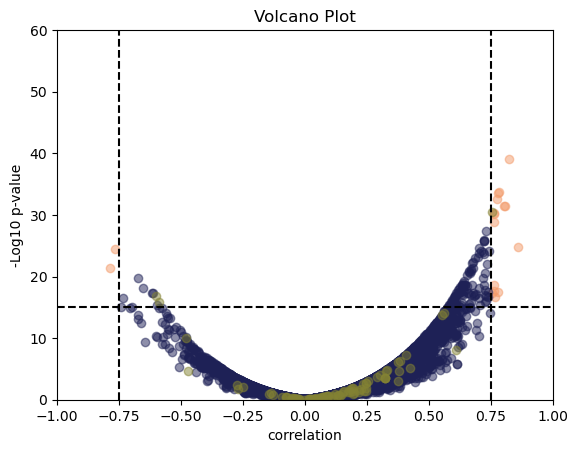

In [97]:
# Define cutoffs for significant differentially expressed genes
pvalue_cutoff = 1e-15
logfc_cutoff = 0.75
manual_ogs= list(interaction.keys())


# Create a new column to label genes that meet the cutoffs as significant
dat_classic['Significant'] = ((dat_classic['pvalue'] < pvalue_cutoff) & (abs(dat_classic['correlation']) > logfc_cutoff)).map({True:'Yes', False:'No'})
for i, row in dat_classic.iterrows():
    if i.startswith(tuple(manual_ogs)):
        dat_classic.at[i,'Significant']= 'Manual'
        
for i, row in dat_classic.iterrows():
    if i.startswith('KOG3302@euNOG_KOG0871@euNOG'):
        dat_classic.at[i,'Significant']= 'Manual'
for i, row in dat_classic.iterrows():
    if i.startswith('KOG3302@euNOG_KOG0392@euNOG'):
        dat_classic.at[i,'Significant']= 'Manual'
for i, row in dat_classic.iterrows():
    if i.startswith('KOG3302@euNOG_KOG1659@euNOG'):
        dat_classic.at[i,'Significant']= 'Manual'
    
# Create volcano plot
# Create a volcano plot
plt.scatter(dat_classic[dat_classic['Significant'] == 'Yes']['correlation'],
            -1 * np.log10(dat_classic[dat_classic['Significant'] == 'Yes']['pvalue']),
            c='#F39B6A', label='Yes', alpha=0.5)

plt.scatter(dat_classic[dat_classic['Significant'] == 'No']['correlation'],
            -1 * np.log10(dat_classic[dat_classic['Significant'] == 'No']['pvalue']),
            c='#1E2156', label='No', alpha=0.5)

plt.scatter(dat_classic[dat_classic['Significant'] == 'Manual']['correlation'],
            -1 * np.log10(dat_classic[dat_classic['Significant'] == 'Manual']['pvalue']),
            c='#838233', label='Manual', alpha=0.5)
plt.xlabel('correlation')
plt.ylabel('-Log10 p-value')
plt.title('Volcano Plot')
plt.axvline(x=-1 * logfc_cutoff, color='black', linestyle='--')
plt.axvline(x=logfc_cutoff, color='black', linestyle='--')
plt.axhline(y=-1 * pd.np.log10(pvalue_cutoff), color='black', linestyle='--')
plt.xlim(-1, 1)
plt.ylim(0, 60)
plt.savefig('../rerun_meme_mast/Vulcanoplot_classic_manual.pdf')
plt.show()

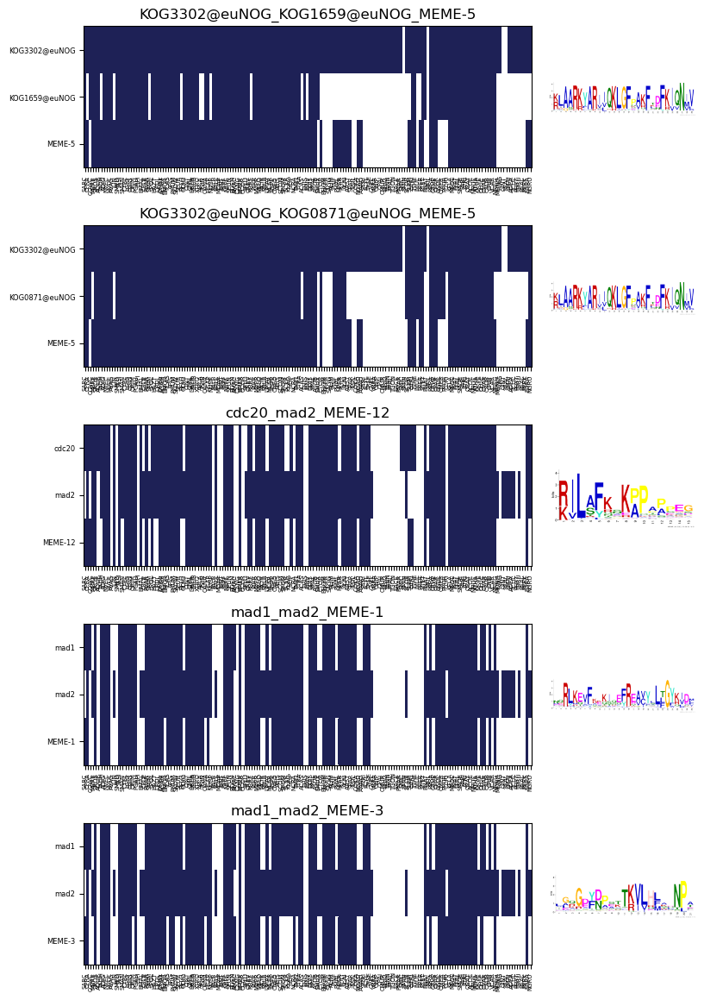

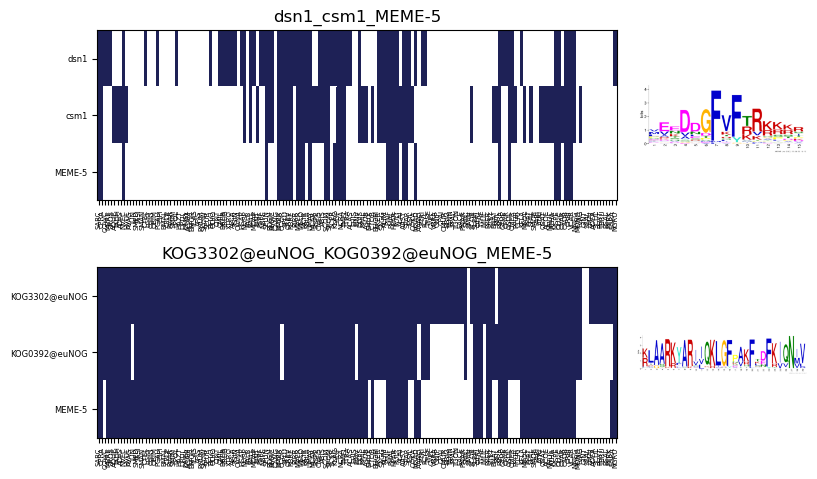

In [397]:
filtered_df = dat_classic[dat_classic['Significant'] == 'Manual']
list_output=[]
for i, row in filtered_df.iterrows():
    list_output+=[i]
#print(sorted(list_output))
list_of_interst = ['KOG3302@euNOG_KOG1659@euNOG_MEME-5','KOG3302@euNOG_KOG0871@euNOG_MEME-5','cdc20_mad2_MEME-12','mad1_mad2_MEME-1','mad1_mad2_MEME-3','dsn1_csm1_MEME-5','KOG3302@euNOG_KOG0392@euNOG_MEME-5']
present_absent_motif_list_logo_pages(list_of_interst,'LECA_profiles_pearson_classic_pages_Manual','classic')

# I want to run alphafold for every protein in my top for that we need to check which species have only one ortlog for both species

In [208]:
Eggnog={} 
for line in open('/home/laurar/laurar2/Data/eukarya/annotations/eggnog/Orthogroups_EggNOG_hmmer_corrected.txt'):
    l= line.split(':')
    Eggnog[l[0]] =l[1].split() 
order_interest = ['HSAP'] + ['SCER'] + ['ATHA']+ superright['Opisthokonta'] + superleft['Archaeplastida']+superleft['SAR']


In [209]:
#import eukarya4
record_dict = SeqIO.to_dict(SeqIO.parse("/home/laurar/laurar2/Data/eukarya/data_set/eukarya_proteomes_lt_core.fa", "fasta"))

In [118]:
seen_combinations = set()  # Set to store seen combinations

for i in list_of_interst_differential:
    m = i.split('_')

    combination = m[0] + '_' + m[1]

    if combination in seen_combinations:
        print("Combination", combination, "has already been processed.")
        continue

    seen_combinations.add(combination)

    species_found = False 
    for j, species in enumerate(Speciesorder):
        if species in motifs_pa['differential'][m[0] + '_' + m[1]][m[2]]:
            profile_vectors[j] = 1
    
    # Function to count occurrences of species in a given list
    def count_species(list):
        counts = {}
        for item in list:
            species = item[:4]
            if species in counts:
                counts[species] += 1
            else:
                counts[species] = 1
        return counts

    counts1 = count_species(Eggnog[m[0]])
    counts2 = count_species(Eggnog[m[1]])
    # Find species that appear only once in both lists
    species_unique_to_both = []
    for species, count in counts1.items():
        if count == 1 and counts2.get(species, 0) == 1:
            species_unique_to_both.append(species)

    # Find the first species that appears in order_interest and meets the criteria
    if not species_unique_to_both:
        print("No species that appear only once in both lists were found.", i)
        species_found = False
        
    for sp in order_interest:
        if sp in species_unique_to_both and profile_vectors[Speciesorder.index(sp)] == 1:
            print(sp,i)
            species_found = True
            break

    # Collect the complete names of species in Eggnog[m[0]] for the found species
    if species_found:
        species_names = []
        for item in Eggnog[m[0]]:
            if item[:4] == sp:
                species_names.append(item)
        for item in Eggnog[m[1]]:
            if item[:4] == sp:
                species_names.append(item)
        with open('../Alphafold/Pearson/' + combination + '.fa', 'a+') as output_handle:
            sequence_a = record_dict[species_names[0]].seq
            sequence_b = record_dict[species_names[1]].seq
            combined_sequence = f"{sequence_a}:{sequence_b}"
            fasta_header = f">{combination}"
            output_handle.write(f"{fasta_header}\n{combined_sequence}\n")

        print("Species Names in Eggnog for", sp, ":", species_names)


for i in list_of_interst_discrimtaive:
    m = i.split('_')

    combination = m[0] + '_' + m[1]

    if combination in seen_combinations:
        print("Combination", combination, "has already been processed.")
        continue

    seen_combinations.add(combination)

    species_found = False 
    for j, species in enumerate(Speciesorder):
        if species in motifs_pa['discrimative'][m[0] + '_' + m[1]][m[2]]:
            profile_vectors[j] = 1
    
    # Function to count occurrences of species in a given list
    def count_species(list):
        counts = {}
        for item in list:
            species = item[:4]
            if species in counts:
                counts[species] += 1
            else:
                counts[species] = 1
        return counts

    counts1 = count_species(Eggnog[m[0]])
    counts2 = count_species(Eggnog[m[1]])
    # Find species that appear only once in both lists
    species_unique_to_both = []
    for species, count in counts1.items():
        if count == 1 and counts2.get(species, 0) == 1:
            species_unique_to_both.append(species)

    # Find the first species that appears in order_interest and meets the criteria
    if not species_unique_to_both:
        print("No species that appear only once in both lists were found.", i)
        species_found = False
        
    for sp in order_interest:
        if sp in species_unique_to_both and profile_vectors[Speciesorder.index(sp)] == 1:
            print(sp,i)
            species_found = True
            break

    # Collect the complete names of species in Eggnog[m[0]] for the found species
    if species_found:
        species_names = []
        for item in Eggnog[m[0]]:
            if item[:4] == sp:
                species_names.append(item)
        for item in Eggnog[m[1]]:
            if item[:4] == sp:
                species_names.append(item)
        with open('../Alphafold/Pearson/' + combination + '.fa', 'a+') as output_handle:
            sequence_a = record_dict[species_names[0]].seq
            sequence_b = record_dict[species_names[1]].seq
            combined_sequence = f"{sequence_a}:{sequence_b}"
            fasta_header = f">{combination}"
            output_handle.write(f"{fasta_header}\n{combined_sequence}\n")

        print("Species Names in Eggnog for", sp, ":", species_names)


HVUL KOG2391@euNOG_KOG0665@euNOG_MEME-1
Species Names in Eggnog for HVUL : ['HVUL000181', 'HVUL013540']
SARC KOG2166@euNOG_KOG0281@euNOG_MEME-1
Species Names in Eggnog for SARC : ['SARC002766', 'SARC009714']
ILIN KOG0787@euNOG_KOG4194@euNOG_MEME-1
Species Names in Eggnog for ILIN : ['ILIN001387', 'ILIN003727']
Combination KOG2166@euNOG_KOG0281@euNOG has already been processed.
SCER KOG2292@euNOG_KOG2291@euNOG_MEME-7
Species Names in Eggnog for SCER : ['SCER000728', 'SCER004273']
HSAP KOG3833@euNOG_KOG0349@euNOG_MEME-7
Species Names in Eggnog for HSAP : ['HSAP096334', 'HSAP056265']
SARC KOG2180@euNOG_KOG3065@euNOG_MEME-1
Species Names in Eggnog for SARC : ['SARC017814', 'SARC018715']
SARC KOG1724@euNOG_KOG0281@euNOG_MEME-2
Species Names in Eggnog for SARC : ['SARC005952', 'SARC009714']
AQUE KOG1190@euNOG_KOG0115@euNOG_MEME-2
Species Names in Eggnog for AQUE : ['AQUE031854', 'AQUE019457']
Combination KOG2292@euNOG_KOG2291@euNOG has already been processed.
Combination KOG2292@euNOG_KOG229

In [138]:
seen_combinations = set()
for i in list_of_interst_differential:
    m = i.split('_')

    combination = m[0] + '_' + m[1]

    if combination in seen_combinations:
        print("Combination", combination, "has already been processed.")
        continue

    seen_combinations.add(combination)

    species_found = False 
    for j, species in enumerate(Speciesorder):
        if species in motifs_pa['differential'][m[0] + '_' + m[1]][m[2]]:
            profile_vectors[j] = 1
    
    # Function to count occurrences of species in a given list
    def count_species(list):
        counts = {}
        for item in list:
            species = item[:4]
            if species in counts:
                counts[species] += 1
            else:
                counts[species] = 1
        return counts

    counts1 = count_species(Eggnog[m[0]])
    counts2 = count_species(Eggnog[m[1]])
    # Find species that appear only once in both lists
    species_unique_to_both = []
    for species, count in counts1.items():
        if count == 1 and counts2.get(species, 0) == 1:
            species_unique_to_both.append(species)

    # Find the first species that appears in order_interest and meets the criteria
    if not species_unique_to_both:
        print("No species that appear only once in both lists were found.", i)
        species_found = False
        
    for sp in order_interest:
        if sp in species_unique_to_both and profile_vectors[Speciesorder.index(sp)] == 1:
            if sp in motifs_pa['differential'][m[0] + '_' + m[1]][m[2]]:
                print(sp,i)
                species_found = True
                break

HVUL KOG2391@euNOG_KOG0665@euNOG_MEME-1
ILIN KOG0787@euNOG_KOG4194@euNOG_MEME-1
SARC KOG2166@euNOG_KOG0281@euNOG_MEME-4
SCER KOG2292@euNOG_KOG2291@euNOG_MEME-7
HSAP KOG3833@euNOG_KOG0349@euNOG_MEME-7
SARC KOG2180@euNOG_KOG3065@euNOG_MEME-1
SARC KOG1724@euNOG_KOG0281@euNOG_MEME-2
AQUE KOG1190@euNOG_KOG0115@euNOG_MEME-2
Combination KOG2292@euNOG_KOG2291@euNOG has already been processed.
Combination KOG2292@euNOG_KOG2291@euNOG has already been processed.
Combination KOG2166@euNOG_KOG0281@euNOG has already been processed.
SCER KOG2292@euNOG_KOG2754@euNOG_MEME-6
Combination KOG2292@euNOG_KOG2291@euNOG has already been processed.
Combination KOG2180@euNOG_KOG3065@euNOG has already been processed.
No species that appear only once in both lists were found. KOG1342@euNOG_KOG0115@euNOG_MEME-2
AQUE KOG4204@euNOG_KOG0115@euNOG_MEME-7
SCER KOG1795@euNOG_KOG2441@euNOG_MEME-1
CELE KOG0543@euNOG_KOG1710@euNOG_MEME-1
ILIN KOG1010@euNOG_KOG0067@euNOG_MEME-2
MBRE KOG0145@euNOG_KOG0696@euNOG_MEME-5
No spe

In [139]:
seen_combinations = set()
for i in list_of_interst_discrimtaive:
    m = i.split('_')

    combination = m[0] + '_' + m[1]

    if combination in seen_combinations:
        print("Combination", combination, "has already been processed.")
        continue

    seen_combinations.add(combination)

    species_found = False 
    for j, species in enumerate(Speciesorder):
        if species in motifs_pa['discrimative'][m[0] + '_' + m[1]][m[2]]:
            profile_vectors[j] = 1
    
    # Function to count occurrences of species in a given list
    def count_species(list):
        counts = {}
        for item in list:
            species = item[:4]
            if species in counts:
                counts[species] += 1
            else:
                counts[species] = 1
        return counts

    counts1 = count_species(Eggnog[m[0]])
    counts2 = count_species(Eggnog[m[1]])
    # Find species that appear only once in both lists
    species_unique_to_both = []
    for species, count in counts1.items():
        if count == 1 and counts2.get(species, 0) == 1:
            species_unique_to_both.append(species)

    # Find the first species that appears in order_interest and meets the criteria
    if not species_unique_to_both:
        print("No species that appear only once in both lists were found.", i)
        species_found = False
        
    for sp in order_interest:
        if sp in species_unique_to_both and profile_vectors[Speciesorder.index(sp)] == 1:
            if sp in motifs_pa['discrimative'][m[0] + '_' + m[1]][m[2]]:
                print(sp,i)
                species_found = True
                break

No species that appear only once in both lists were found. KOG1113@euNOG_KOG3577@euNOG_MEME-8
ATHA KOG2865@euNOG_KOG3382@euNOG_MEME-5
MBRE KOG0145@euNOG_KOG0696@euNOG_MEME-7
NVEC KOG3218@euNOG_0IN7T@euNOG_MEME-6
SARC KOG2166@euNOG_KOG0281@euNOG_MEME-4
SARC KOG4436@euNOG_KOG0281@euNOG_MEME-9
MPOL KOG2151@euNOG_KOG1565@euNOG_MEME-8
ILIN KOG0505@euNOG_0IN7T@euNOG_MEME-4
Combination KOG4436@euNOG_KOG0281@euNOG has already been processed.
Combination KOG2166@euNOG_KOG0281@euNOG has already been processed.
Combination KOG2865@euNOG_KOG3382@euNOG has already been processed.
CFRA KOG2574@euNOG_KOG3002@euNOG_MEME-6
SARC KOG1724@euNOG_KOG0281@euNOG_MEME-5
PCAU KOG0858@euNOG_KOG1792@euNOG_MEME-8
ATHA KOG1875@euNOG_KOG3600@euNOG_MEME-10
Combination KOG0145@euNOG_KOG0696@euNOG has already been processed.
No species that appear only once in both lists were found. KOG1163@euNOG_0IG3U@euNOG_MEME-10
SMED KOG3636@euNOG_KOG3922@euNOG_MEME-1
COWC KOG2829@euNOG_0IRVA@euNOG_MEME-3
TASI KOG4508@euNOG_KOG1565

In [140]:
species_names = []
sp = 'HPAR'
combination = 'KOG0796@euNOG_KOG4795@euNOG'
for item in Eggnog['KOG0796@euNOG']:
    if item[:4] == sp:
        species_names.append(item)
for item in Eggnog['KOG4795@euNOG']:
    if item[:4] == sp:
        species_names.append(item)
with open('../Alphafold/Pearson/Rerun_new/' + combination + '.fa', 'a+') as output_handle:
    sequence_a = record_dict[species_names[0]].seq
    sequence_b = record_dict[species_names[1]].seq
    combined_sequence = f"{sequence_a}:{sequence_b}"
    fasta_header = f">{combination}"
    output_handle.write(f"{fasta_header}\n{combined_sequence}\n")

print("Species Names in Eggnog for", sp, ":", species_names)

species_names = []
sp ='CELE'
combination='KOG0543@euNOG_KOG1710@euNOG'
for item in Eggnog['KOG0543@euNOG']:
    if item[:4] == sp:
        species_names.append(item)
for item in Eggnog['KOG1710@euNOG']:
    if item[:4] == sp:
        species_names.append(item)
with open('../Alphafold/Pearson/Rerun_new/' + combination + '.fa', 'a+') as output_handle:
    sequence_a = record_dict[species_names[0]].seq
    sequence_b = record_dict[species_names[1]].seq
    combined_sequence = f"{sequence_a}:{sequence_b}"
    fasta_header = f">{combination}"
    output_handle.write(f"{fasta_header}\n{combined_sequence}\n")

print("Species Names in Eggnog for", sp, ":", species_names)

Species Names in Eggnog for HPAR : ['HPAR001519', 'HPAR010078']
Species Names in Eggnog for CELE : ['CELE002217', 'CELE001303']


In [405]:
seen_combinations = set()
for i in list_of_interst_classic:
    m = i.split('_')

    combination = m[0] + '_' + m[1]

    if combination in seen_combinations:
        print("Combination", combination, "has already been processed.")
        continue

    seen_combinations.add(combination)

    species_found = False 
    for j, species in enumerate(Speciesorder):
        if species in motifs_pa['classic'][m[0] + '_' + m[1]][m[2]]:
            profile_vectors[j] = 1
    
    # Function to count occurrences of species in a given list
    def count_species(list):
        counts = {}
        for item in list:
            species = item[:4]
            if species in counts:
                counts[species] += 1
            else:
                counts[species] = 1
        return counts

    counts1 = count_species(Eggnog[m[0]])
    counts2 = count_species(Eggnog[m[1]])
    # Find species that appear only once in both lists
    species_unique_to_both = []
    for species, count in counts1.items():
        if count == 1 and counts2.get(species, 0) == 1:
            species_unique_to_both.append(species)

    # Find the first species that appears in order_interest and meets the criteria
    if not species_unique_to_both:
        print("No species that appear only once in both lists were found.", i)
        species_found = False
        
    for sp in order_interest:
        if sp in species_unique_to_both and profile_vectors[Speciesorder.index(sp)] == 1:
            if sp in motifs_pa['classic'][m[0] + '_' + m[1]][m[2]]:
                print(sp,i)
                species_found = True
                break
      # Collect the complete names of species in Eggnog[m[0]] for the found species
    if species_found:
        species_names = []
        for item in Eggnog[m[0]]:
            if item[:4] == sp:
                species_names.append(item)
        for item in Eggnog[m[1]]:
            if item[:4] == sp:
                species_names.append(item)
#        with open('../Alphafold/classic/' + combination + '.fa', 'a+') as output_handle:
#            sequence_a = record_dict[species_names[0]].seq
#            sequence_b = record_dict[species_names[1]].seq
#            combined_sequence = f"{sequence_a}:{sequence_b}"
#            fasta_header = f">{combination}"
#            output_handle.write(f"{fasta_header}\n{combined_sequence}\n")

        print("Species Names in Eggnog for", sp, ":", species_names)


OBIM 0KCZ0@euNOG_KOG1048@euNOG_MEME-6
Species Names in Eggnog for OBIM : ['OBIM032097', 'OBIM026219']
ILIN KOG4203@euNOG_KOG0200@euNOG_MEME-11
Species Names in Eggnog for ILIN : ['ILIN007329', 'ILIN004287']
COWC KOG1950@euNOG_KOG3742@euNOG_MEME-11
Species Names in Eggnog for COWC : ['COWC007064', 'COWC002054']
ILIN KOG0787@euNOG_KOG4194@euNOG_MEME-10
Species Names in Eggnog for ILIN : ['ILIN001387', 'ILIN003727']
SCER KOG2292@euNOG_KOG2291@euNOG_MEME-6
Species Names in Eggnog for SCER : ['SCER000728', 'SCER004273']
Combination KOG2292@euNOG_KOG2291@euNOG has already been processed.
Combination 0KCZ0@euNOG_KOG1048@euNOG has already been processed.
NVEC KOG3218@euNOG_0IN7T@euNOG_MEME-5
Species Names in Eggnog for NVEC : ['NVEC006578', 'NVEC005090']
SMED KOG3636@euNOG_KOG3922@euNOG_MEME-2
Species Names in Eggnog for SMED : ['SMED015946', 'SMED008226']
AQUE KOG2966@euNOG_KOG1141@euNOG_MEME-6
Species Names in Eggnog for AQUE : ['AQUE031868', 'AQUE029147']
COWC KOG2608@euNOG_KOG0912@euNOG_ME

In [410]:
motifs_pa['classic']['KOG3414@euNOG_0IGQ1@euNOG']['MEME-7']

['AQUE',
 'TADH',
 'NVEC',
 'HVUL',
 'CTEL',
 'LGIG',
 'CGIG',
 'OBIM',
 'PCAU',
 'SMIM',
 'LPOL',
 'SKOW',
 'SPUR',
 'BFLO',
 'CMIL',
 'DRER',
 'TRUB',
 'XTRO',
 'APLA',
 'PSIN',
 'HSAP',
 'PSPF',
 'NSPE',
 'BMER',
 'CCOR',
 'ACAS',
 'PINF',
 'PHAL',
 'PULT',
 'ALAI',
 'SPAR',
 'MPOL',
 'PPAT',
 'SFAL',
 'SMOE',
 'PABI',
 'ATRI',
 'OSAT',
 'ACOE',
 'NNUC',
 'ATHA']

In [409]:
list_of_interst_classic

Index(['0KCZ0@euNOG_KOG1048@euNOG_MEME-6',
       'KOG4203@euNOG_KOG0200@euNOG_MEME-11',
       'KOG1950@euNOG_KOG3742@euNOG_MEME-11',
       'KOG0787@euNOG_KOG4194@euNOG_MEME-10',
       'KOG2292@euNOG_KOG2291@euNOG_MEME-6',
       'KOG2292@euNOG_KOG2291@euNOG_MEME-11',
       '0KCZ0@euNOG_KOG1048@euNOG_MEME-7', 'KOG3218@euNOG_0IN7T@euNOG_MEME-5',
       'KOG3636@euNOG_KOG3922@euNOG_MEME-2',
       'KOG2966@euNOG_KOG1141@euNOG_MEME-6',
       'KOG2608@euNOG_KOG0912@euNOG_MEME-13',
       'KOG3414@euNOG_0IGQ1@euNOG_MEME-7',
       'KOG4369@euNOG_KOG3577@euNOG_MEME-13',
       'KOG4203@euNOG_KOG3002@euNOG_MEME-11',
       'KOG4369@euNOG_KOG3577@euNOG_MEME-6',
       'KOG3302@euNOG_KOG0871@euNOG_MEME-5',
       'KOG2993@euNOG_KOG4049@euNOG_MEME-14',
       'KOG3148@euNOG_KOG3892@euNOG_MEME-12'],
      dtype='object')

# Can we get some statistics about the motifs

In [210]:
Direc = '../rerun_meme_mast/Eggnog_corrected_pairs/'
entries = os.listdir(Direc)
statisics_motifs={}
statisics_motifs['differential']={}
for dirt in entries:
    dic_chi_square = {}
    statisics_motifs['differential'][dirt]={}
    with cd(Direc+dirt):
        try:
            with open('meme.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))
                meme_motif = {}
                for l in range(len(meme_json["motifs"])):
                    meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"],meme_json["motifs"][l]["ic"], meme_json["motifs"][l]["len"], meme_json["motifs"][l]["llr"],meme_json["motifs"][l]["re"]
        except:
            print(Direc+dirt)
    statisics_motifs['differential'][dirt]= meme_motif            
Direc = '../meme-output/Eggnog_corrected_pairs/'
entries = os.listdir(Direc)
statisics_motifs['discrimative']={}
for dirt in entries:
    dic_chi_square = {}
    statisics_motifs['discrimative'][dirt]={}
    with cd(Direc+dirt):
        try:
            with open('meme.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))
                meme_motif = {}
                for l in range(len(meme_json["motifs"])):
                    meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"],meme_json["motifs"][l]["ic"], meme_json["motifs"][l]["len"], meme_json["motifs"][l]["llr"],meme_json["motifs"][l]["re"]
        except:
            print(Direc+dirt)
    statisics_motifs['discrimative'][dirt]=meme_motif

Direc ='../classic_meme/classic_meme_/home/fasta_eggnog_corrected/'
entries = os.listdir(Direc)
statisics_motifs['classic']={}
for dirt in entries:
    dic_chi_square = {}
    statisics_motifs['classic'][dirt]={}
    with cd(Direc+dirt):
        try:
            with open('meme.html', 'r') as mast:
                meme_html = mast.read()
                json_text = re.compile('var data = ({.*?});', re.DOTALL)
                matches = json_text.search(meme_html)
                meme_json = json.loads(matches.group(1))
                meme_motif = {}
                for l in range(len(meme_json["motifs"])):
                    meme_motif[meme_json["motifs"][l]['alt']]=meme_json["motifs"][l]["evalue"],meme_json["motifs"][l]["ic"], meme_json["motifs"][l]["len"], meme_json["motifs"][l]["llr"],meme_json["motifs"][l]["re"]
        except:
            print(Direc+dirt)
    dirt= dirt.split('.')[0]
    statisics_motifs['classic'][dirt]=meme_motif

../rerun_meme_mast/Eggnog_corrected_pairs/KOG1752@euNOG_0IGM9@euNOG
../rerun_meme_mast/Eggnog_corrected_pairs/KOG2542@euNOG_0IH4U@euNOG
../rerun_meme_mast/Eggnog_corrected_pairs/KOG3939@euNOG_0IE2X@euNOG
../meme-output/Eggnog_corrected_pairs/KOG1752@euNOG_0IGM9@euNOG
../meme-output/Eggnog_corrected_pairs/KOG2542@euNOG_0IH4U@euNOG
../meme-output/Eggnog_corrected_pairs/KOG3939@euNOG_0IE2X@euNOG
../classic_meme/classic_meme_/home/fasta_eggnog_corrected/KOG3939@euNOG_0IE2X@euNOG.fa
../classic_meme/classic_meme_/home/fasta_eggnog_corrected/KOG2542@euNOG_0IH4U@euNOG.fa
../classic_meme/classic_meme_/home/fasta_eggnog_corrected/KOG1752@euNOG_0IGM9@euNOG.fa


In [211]:
statisics_motifs['discrimative']

{'KOG0811@euNOG_KOG0860@euNOG': {'MEME-1': ('5.3e-2769',
   101.5,
   41,
   8645,
   89.7),
  'MEME-2': ('7.3e-1377', 79.6, 41, 5167, 66.0),
  'MEME-3': ('3.1e-512', 40.3, 21, 2501, 34.4),
  'MEME-4': ('9.3e-1125', 71.6, 41, 4512, 60.8),
  'MEME-5': ('2.1e-279', 18.4, 8, 1630, 20.1),
  'MEME-6': ('1.0e-507', 32.4, 15, 2454, 27.2),
  'MEME-7': ('9.0e-390', 32.6, 15, 2119, 25.9),
  'MEME-8': ('5.3e-248', 24.5, 12, 1763, 20.2),
  'MEME-9': ('4.7e-134', 33.8, 15, 925, 33.4),
  'MEME-10': ('4.6e-044', 88.2, 29, 511, 81.9)},
 'KOG3302@euNOG_KOG0531@euNOG': {'MEME-1': ('1.6e-4058',
   78.9,
   29,
   12635,
   76.0),
  'MEME-2': ('3.4e-4892', 84.8, 29, 14804, 79.7),
  'MEME-3': ('6.9e-3329', 66.9, 22, 10485, 64.1),
  'MEME-4': ('4.0e-2898', 56.7, 21, 9633, 53.0),
  'MEME-5': ('1.7e-1936', 51.8, 21, 7002, 48.1),
  'MEME-6': ('4.5e-1998', 51.6, 16, 6847, 47.0),
  'MEME-7': ('1.2e-1303', 50.9, 15, 4533, 46.7),
  'MEME-8': ('4.4e-1466', 36.0, 11, 5602, 32.3),
  'MEME-9': ('9.7e-362', 36.8, 21, 2

In [110]:
# Flatten the layered dictionary
flattened_data = {}
for key1, inner_dict in statisics_motifs['discrimative'].items():
    for key2, value in inner_dict.items():
        new_key = f"{key1}_{key2}"
        flattened_data[new_key] = value

# Create a DataFrame from the flattened data
df = pd.DataFrame.from_dict(flattened_data, orient='index', columns=['E-value', 'information content', 'Length', 'log likelihood ratio','relative entropy'])

print(df)

# Flatten the layered dictionary
flattened_data = {}
for key1, inner_dict in statisics_motifs['differential'].items():
    for key2, value in inner_dict.items():
        new_key = f"{key1}_{key2}"
        flattened_data[new_key] = value

# Create a DataFrame from the flattened data
df_dif = pd.DataFrame.from_dict(flattened_data, orient='index', columns=['E-value', 'information content', 'Length', 'log likelihood ratio','relative entropy'])

print(df_dif)

# Flatten the layered dictionary
flattened_data = {}
for key1, inner_dict in statisics_motifs['classic'].items():
    for key2, value in inner_dict.items():
        new_key = f"{key1}_{key2}"
        flattened_data[new_key] = value

# Create a DataFrame from the flattened data
df_clas = pd.DataFrame.from_dict(flattened_data, orient='index', columns=['E-value', 'information content', 'Length', 'log likelihood ratio','relative entropy'])

print(df_clas)

                                      E-value  information content  Length  \
KOG0811@euNOG_KOG0860@euNOG_MEME-1  5.3e-2769                101.5      41   
KOG0811@euNOG_KOG0860@euNOG_MEME-2  7.3e-1377                 79.6      41   
KOG0811@euNOG_KOG0860@euNOG_MEME-3   3.1e-512                 40.3      21   
KOG0811@euNOG_KOG0860@euNOG_MEME-4  9.3e-1125                 71.6      41   
KOG0811@euNOG_KOG0860@euNOG_MEME-5   2.1e-279                 18.4       8   
...                                       ...                  ...     ...   
KOG0810@euNOG_0II16@euNOG_MEME-6     2.6e-445                 60.1      24   
KOG0810@euNOG_0II16@euNOG_MEME-7     4.9e-328                 31.8      11   
KOG0810@euNOG_0II16@euNOG_MEME-8     6.2e-252                 31.6      15   
KOG0810@euNOG_0II16@euNOG_MEME-9     1.1e-218                 29.7      13   
KOG0810@euNOG_0II16@euNOG_MEME-10    4.4e-125                 35.0      11   

                                    log likelihood ratio  relat

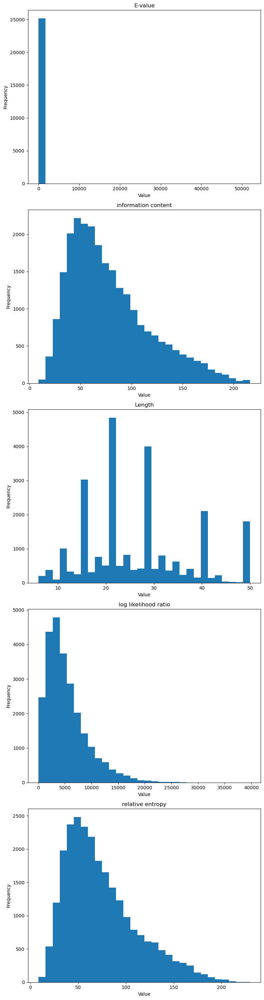

In [116]:
df = df.apply(pd.to_numeric, errors='coerce')
# Create subplots for each column
fig, axs = plt.subplots(nrows=len(df.columns), figsize=(8, 6 * len(df.columns)))

# Iterate over each column and create a distribution plot
for i, column in enumerate(df.columns):
    ax = axs[i]
    ax.hist(df[column], bins=30)  # Adjust the number of bins as needed
    ax.set_title(column)
    ax.set_xlabel("Value")
    ax.set_ylabel("Frequency")

# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()


In [115]:
# Flatten the layered dictionary
flattened_data = {}
for key1, inner_dict in statisics_motifs['differential'].items():
    for key2, value in inner_dict.items():
        new_key = f"{key1}_{key2}"
        flattened_data[new_key] = value

# Create a DataFrame from the flattened data
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assume 'df' and 'df_dif' are your DataFrames

# Convert values in DataFrame columns to numeric data types
df = df.apply(pd.to_numeric, errors='coerce')
df_dif = df_dif.apply(pd.to_numeric, errors='coerce')

# Define the color palette
color_palette = sns.color_palette("Set2", 2)

# Create subplots for each column
fig, axs = plt.subplots(nrows=len(df.columns), ncols=1, figsize=(8, 6 * len(df.columns)))

# Iterate over each column and create distribution plots for each DataFrame
for i, (column1, column2) in enumerate(zip(df.columns, df_dif.columns)):
    ax = axs[i]  # Select the subplot for the current column
    
    # Plot distribution for DataFrame 1
    ax.hist(df[column1].dropna(), bins=20, alpha=0.5, label='DataFrame 1', color=color_palette[0])  # Adjust the number of bins as needed
    
    # Plot distribution for DataFrame 2
    ax.hist(df_dif[column2].dropna(), bins=20, alpha=0.5, label='DataFrame 2', color=color_palette[1])  # Adjust the number of bins as needed
    
    ax.set_title(column1)
    ax.set_xlabel("Value")
    ax.set_ylabel("Frequency")
    ax.legend()

# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()
 = pd.DataFrame.from_dict(flattened_data, orient='index', columns=['E-value', 'information content', 'Length'])

print(df_dif)
df_dif = df_dif.apply(pd.to_numeric, errors='coerce')
# Create subplots for each column
fig, axs = plt.subplots(nrows=len(df_dif.columns), figsize=(8, 6 * len(df_dif.columns)))

# Iterate over each column and create a distribution plot
for i, column in enumerate(df_dif.columns):
    ax = axs[i]
    ax.hist(df_dif[column], bins=30)  # Adjust the number of bins as needed
    ax.set_title(column)
    ax.set_xlabel("Value")
    ax.set_ylabel("Frequency")

# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()

IndentationError: unexpected indent (1313678150.py, line 45)

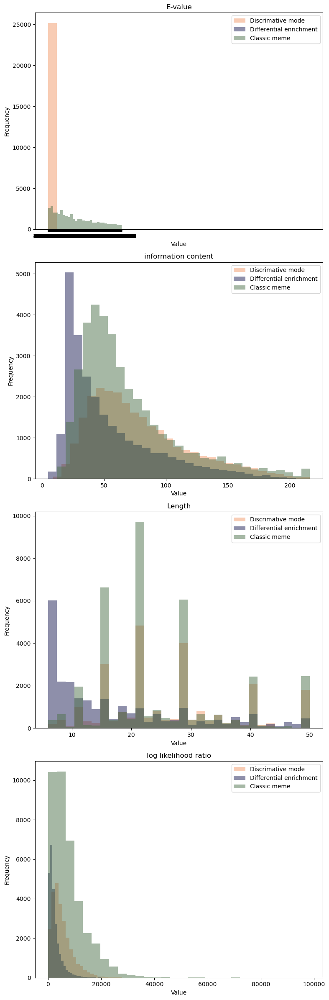

In [183]:
import seaborn as sns

# Convert values in DataFrame columns to numeric data types
df = df.apply(pd.to_numeric, errors='coerce')
df_dif = df_dif.apply(pd.to_numeric, errors='coerce')


# Create subplots for each column
fig, axs = plt.subplots(nrows=len(df.columns), ncols=1, figsize=(8, 6 * len(df.columns)))

# Iterate over each column and create distribution plots for each DataFrame
for i, (column1, column2) in enumerate(zip(df.columns, df_dif.columns)):
    ax = axs[i]  # Select the subplot for the current column
    
    # Plot distribution for DataFrame 1
    ax.hist(df[column1].dropna(), bins=30, alpha=0.5, label='Discrimative mode',color='#F39B6A')  # Adjust the number of bins as needed
    
    # Plot distribution for DataFrame 2
    ax.hist(df_dif[column2].dropna(), bins=30, alpha=0.5, label='Differential enrichment',color='#1E2156')  # Adjust the number of bins as needed
    
    # Plot distribution for DataFrame 3
    ax.hist(df_clas[column2].dropna(), bins=30, alpha=0.5, label='Classic meme',color='#4f724c')  # Adjust the number of bins as needed

    ax.set_title(column1)
    ax.set_xlabel("Value")
    ax.set_ylabel("Frequency")
    ax.legend()

# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()

0.3502779984114377 0.0
0.46528991262907066 0.0
0.4139396346306593 0.0


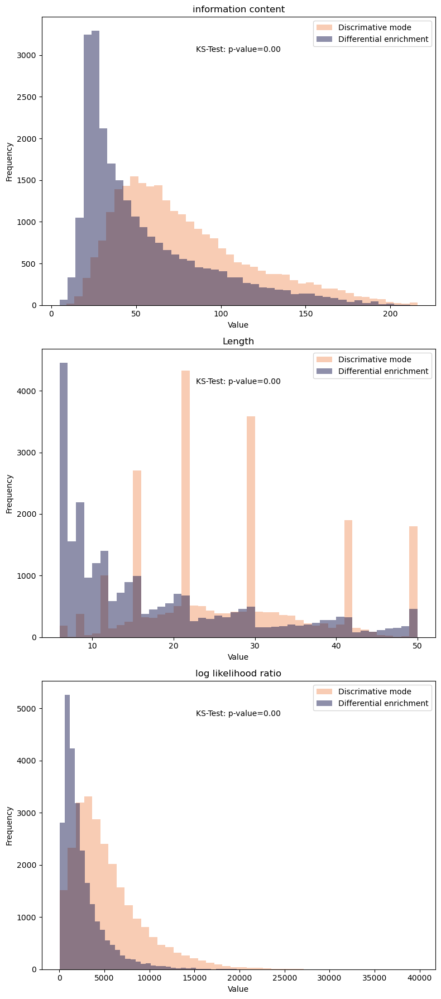

In [141]:
from scipy.stats import ks_2samp
# Create subplots for each column except the first one
fig, axs = plt.subplots(nrows=len(df.columns) - 1, ncols=1, figsize=(8, 6 * (len(df.columns) - 1)))


# Iterate over each column (except the first one) and create distribution plots for each DataFrame
for i, (column1, column2) in enumerate(zip(df.columns[1:], df_dif.columns[1:]), start=1):
    ax = axs[i-1]  # Select the subplot for the current column
    
    # Plot distribution for DataFrame 1
    ax.hist(df[column1].dropna(), bins=44, alpha=0.5, label='Discrimative mode',color='#F39B6A')  # Adjust the number of bins as needed
    
    # Plot distribution for DataFrame 2
    ax.hist(df_dif[column2].dropna(), bins=44, alpha=0.5, label='Differential enrichment',color='#1E2156')  # Adjust the number of bins as needed
    
    # Perform Kolmogorov-Smirnov test
    stat, p_value = ks_2samp(df[column1].dropna(), df_dif[column2].dropna())
    print(stat,p_value)
    ax.set_title(column1)
    ax.set_xlabel("Value")
    ax.set_ylabel("Frequency")
    ax.legend()
    
    # Add test results to the plot
    ax.text(0.5, 0.9, f"KS-Test: p-value={p_value:.2f}", transform=ax.transAxes, ha='center', va='top')

# Adjust spacing between subplots
plt.tight_layout()

plt.savefig('../rerun_meme_mast/motif_stastistics.pdf')

# Show the figure
plt.show()

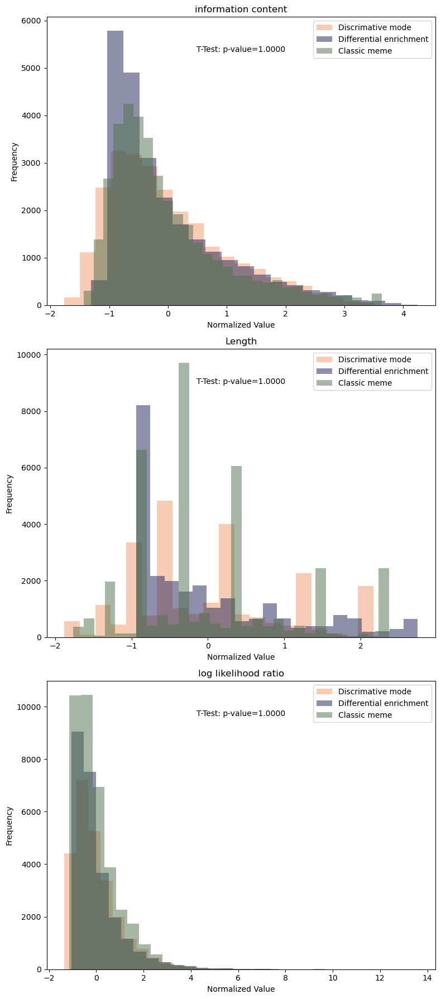

In [186]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from scipy.stats import ttest_ind
from sklearn.preprocessing import StandardScaler

# Assume 'df' and 'df_dif' are your DataFrames

# Convert values in DataFrame columns to numeric data types
df = df.apply(pd.to_numeric, errors='coerce')
df_dif = df_dif.apply(pd.to_numeric, errors='coerce')
df_clas=df_clas.apply(pd.to_numeric, errors='coerce')

# Create a StandardScaler instance
scaler = StandardScaler()

# Normalize the data based on frequency
df_normalized = df.apply(lambda col: (col - col.mean()) / col.std())
df_dif_normalized = df_dif.apply(lambda col: (col - col.mean()) / col.std())
df_clas_normalized = df_clas.apply(lambda col: (col - col.mean()) / col.std())
# Create subplots for each column except the first one
fig, axs = plt.subplots(nrows=len(df.columns) - 1, ncols=1, figsize=(8, 6 * (len(df.columns) - 1)))

# Get a colormap
cmap = cm.get_cmap('tab10')

# Iterate over each column (except the first one) and create distribution plots for each DataFrame
for i, (column1, column2) in enumerate(zip(df.columns[1:], df_dif.columns[1:]), start=1):
    ax = axs[i-1]  # Select the subplot for the current column
    
    # Plot distribution for DataFrame 1
    ax.hist(df_normalized[column1].dropna(), bins=20, alpha=0.5, label='Discrimative mode',color='#F39B6A')  # Adjust the number of bins as needed
    
    # Plot distribution for DataFrame 2
    ax.hist(df_dif_normalized[column2].dropna(), bins=20, alpha=0.5, label='Differential enrichment',color='#1E2156')  # Adjust the number of bins as needed
    
     # Plot distribution for DataFrame 3
    ax.hist(df_clas_normalized[column2].dropna(), bins=30, alpha=0.5, label='Classic meme',color='#4f724c')  # Adjust the number of bins as needed

    # Perform T-test
    t_stat, p_value = ttest_ind(df_normalized[column1].dropna(), df_dif_normalized[column2].dropna())
    
    ax.set_title(column1)
    ax.set_xlabel("Normalized Value")
    ax.set_ylabel("Frequency")
    ax.legend()
    
    # Add test results to the plot
    ax.text(0.5, 0.9, f"T-Test: p-value={p_value:.4f}", transform=ax.transAxes, ha='center', va='top')

# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()


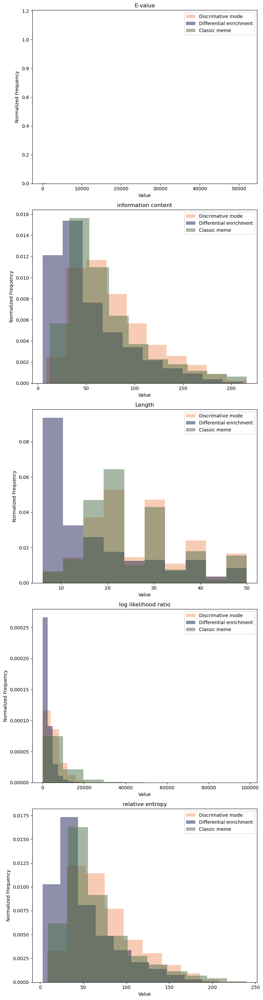

In [114]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert values in DataFrame columns to numeric data types
df = df.apply(pd.to_numeric, errors='coerce')
df_dif = df_dif.apply(pd.to_numeric, errors='coerce')
df_clas = df_clas.apply(pd.to_numeric, errors='coerce')

# Create subplots for each column
fig, axs = plt.subplots(nrows=len(df.columns), ncols=1, figsize=(8, 6 * len(df.columns)))

# Iterate over each column and create distribution plots for each DataFrame
for i, (column1, column2) in enumerate(zip(df.columns, df_dif.columns)):
    ax = axs[i]  # Select the subplot for the current column
    
    # Plot distribution for DataFrame 1
    ax.hist(df[column1].dropna(), alpha=0.5, label='Discrimative mode', color='#F39B6A', density=True)  # Adjust the number of bins as needed
    
    # Plot distribution for DataFrame 2
    ax.hist(df_dif[column2].dropna(), alpha=0.5, label='Differential enrichment', color='#1E2156', density=True)  # Adjust the number of bins as needed
    
    # Plot distribution for DataFrame 3
    ax.hist(df_clas[column2].dropna(), alpha=0.5, label='Classic meme', color='#4f724c', density=True)  # Adjust the number of bins as needed

    ax.set_title(column1)
    ax.set_xlabel("Value")
    ax.set_ylabel("Normalized Frequency")
    ax.legend()

# Adjust spacing between subplots
plt.tight_layout()

#save the figure
plt.savefig('../statistcal_figure.pdf')

# Show the figure
plt.show()


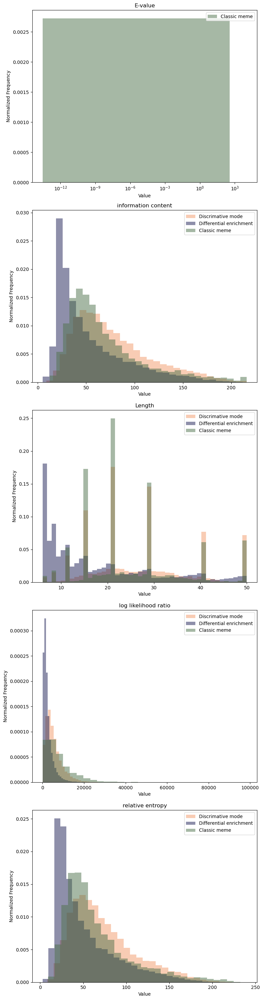

In [285]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert values in DataFrame columns to numeric data types
df = df.apply(pd.to_numeric, errors='coerce')
df_dif = df_dif.apply(pd.to_numeric, errors='coerce')
df_clas = df_clas.apply(pd.to_numeric, errors='coerce')

# Create subplots for each column
fig, axs = plt.subplots(nrows=len(df.columns), ncols=1, figsize=(8, 6 * len(df.columns)))

# Iterate over each column and create distribution plots for each DataFrame

ax = axs[0]  # Select the subplot for the current column

# Plot distribution for DataFrame 1
#ax.hist(df['E-value'].dropna(), bins=30,alpha=0.5, label='Discrimative mode', color='#F39B6A', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 2
#ax.hist(df_dif['E-value'].dropna(),bins=30, alpha=0.5, label='Differential enrichment', color='#1E2156', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 3
ax.hist(df_clas['E-value'].dropna(), bins=30,alpha=0.5, label='Classic meme', color='#4f724c', density=True)  # Adjust the number of bins as needed
ax.set_xscale('log')
ax.set_title('E-value')
ax.set_xlabel("Value")
ax.set_ylabel("Normalized Frequency")
ax.legend()


ax = axs[1]  # Select the subplot for the current column

# Plot distribution for DataFrame 1
ax.hist(df['information content'].dropna(), bins=30,alpha=0.5, label='Discrimative mode', color='#F39B6A', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 2
ax.hist(df_dif['information content'].dropna(),bins=30, alpha=0.5, label='Differential enrichment', color='#1E2156', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 3
ax.hist(df_clas['information content'].dropna(), bins=30,alpha=0.5, label='Classic meme', color='#4f724c', density=True)  # Adjust the number of bins as needed

ax.set_title('information content')
ax.set_xlabel("Value")
ax.set_ylabel("Normalized Frequency")
ax.legend()

ax = axs[2]  # Select the subplot for the current column

# Plot distribution for DataFrame 1
ax.hist(df['Length'].dropna(), bins=45,alpha=0.5, label='Discrimative mode', color='#F39B6A', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 2
ax.hist(df_dif['Length'].dropna(),bins=45, alpha=0.5, label='Differential enrichment', color='#1E2156', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 3
ax.hist(df_clas['Length'].dropna(), bins=45,alpha=0.5, label='Classic meme', color='#4f724c', density=True)  # Adjust the number of bins as needed

ax.set_title('Length')
ax.set_xlabel("Value")
ax.set_ylabel("Normalized Frequency")
ax.legend()
ax = axs[3]  # Select the subplot for the current column

# Plot distribution for DataFrame 1
ax.hist(df['log likelihood ratio'].dropna(), bins=30,alpha=0.5, label='Discrimative mode', color='#F39B6A', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 2
ax.hist(df_dif['log likelihood ratio'].dropna(),bins=30, alpha=0.5, label='Differential enrichment', color='#1E2156', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 3
ax.hist(df_clas['log likelihood ratio'].dropna(), bins=30,alpha=0.5, label='Classic meme', color='#4f724c', density=True)  # Adjust the number of bins as needed

ax.set_title('log likelihood ratio')
ax.set_xlabel("Value")
ax.set_ylabel("Normalized Frequency")
ax.legend()
    
ax = axs[4]  # Select the subplot for the current column

# Plot distribution for DataFrame 1
ax.hist(df['relative entropy'].dropna(), bins=30,alpha=0.5, label='Discrimative mode', color='#F39B6A', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 2
ax.hist(df_dif['relative entropy'].dropna(),bins=30, alpha=0.5, label='Differential enrichment', color='#1E2156', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 3
ax.hist(df_clas['relative entropy'].dropna(), bins=30,alpha=0.5, label='Classic meme', color='#4f724c', density=True)  # Adjust the number of bins as needed

ax.set_title('relative entropy')
ax.set_xlabel("Value")
ax.set_ylabel("Normalized Frequency")
ax.legend()
# Adjust spacing between subplots
plt.tight_layout()
plt.savefig('../statistcal_figure.pdf')

In [168]:
df_clas.loc[df['E-value'].idxmax()]

E-value                   0.0033
information content      27.4000
Length                    8.0000
log likelihood ratio    159.0000
relative entropy         25.5000
Name: 0IWIY@euNOG_0IWFF@euNOG_MEME-10, dtype: float64

Kruskal-Wallis test p-value for "E-value": 0.0
Kruskal-Wallis test p-value for "information content": 0.0
Kruskal-Wallis test p-value for "Length": 0.0
Kruskal-Wallis test p-value for "log likelihood ratio": 0.0
Kruskal-Wallis test p-value for "relative entropy": 0.0


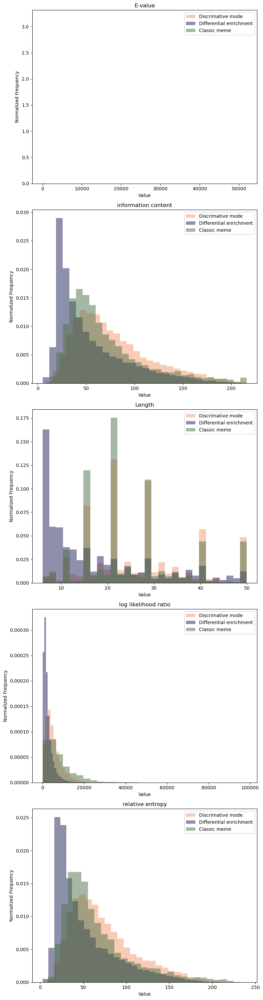

In [171]:
df_clas['E-value']

KOG3172@euNOG_KOG3238@euNOG_MEME-1      0.000000e+00
KOG3172@euNOG_KOG3238@euNOG_MEME-2      0.000000e+00
KOG3172@euNOG_KOG3238@euNOG_MEME-3      0.000000e+00
KOG3172@euNOG_KOG3238@euNOG_MEME-4     3.700000e-114
KOG3172@euNOG_KOG3238@euNOG_MEME-5      2.500000e-98
                                           ...      
KOG1596@euNOG_KOG4356@euNOG_MEME-11    3.500000e-187
KOG1596@euNOG_KOG4356@euNOG_MEME-12    1.100000e-171
KOG1596@euNOG_KOG4356@euNOG_MEME-13    5.800000e-158
KOG1596@euNOG_KOG4356@euNOG_MEME-14    4.300000e-164
KOG1596@euNOG_KOG4356@euNOG_MEME-15    6.800000e-143
Name: E-value, Length: 37770, dtype: float64

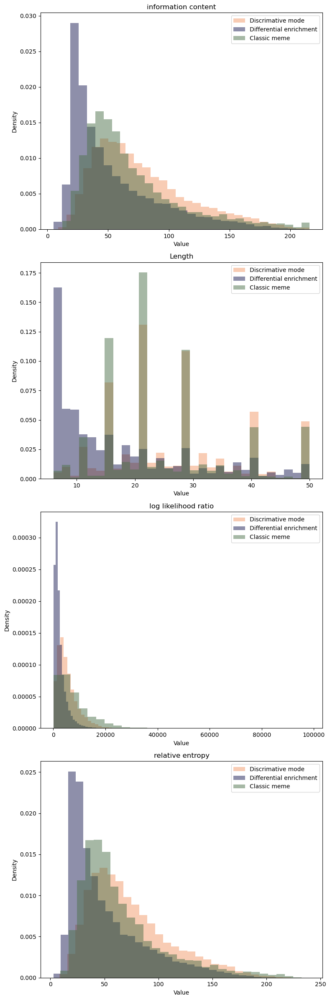

In [163]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert values in DataFrame columns to numeric data types
df = df.apply(pd.to_numeric, errors='coerce')
df_dif = df_dif.apply(pd.to_numeric, errors='coerce')
df_clas = df_clas.apply(pd.to_numeric, errors='coerce')

# Create subplots for each column (excluding the first column)
fig, axs = plt.subplots(nrows=len(df.columns) - 1, ncols=1, figsize=(8, 6 * (len(df.columns) - 1)))

# Iterate over each column (excluding the first column) and create distribution plots for each DataFrame
for i, (column1, column2) in enumerate(zip(df.columns[1:], df_dif.columns[1:])):
    ax = axs[i]  # Select the subplot for the current column
    
    # Plot distribution for DataFrame 1
    ax.hist(df[column1].dropna(), bins=30, alpha=0.5, label='Discrimative mode', color='#F39B6A', density=True)  
    
    # Plot distribution for DataFrame 2
    ax.hist(df_dif[column2].dropna(), bins=30, alpha=0.5, label='Differential enrichment', color='#1E2156', density=True)  
    
    # Plot distribution for DataFrame 3
    ax.hist(df_clas[column2].dropna(), bins=30, alpha=0.5, label='Classic meme', color='#4f724c', density=True)  
    
    ax.set_title(column1)
    ax.set_xlabel("Value")
    ax.set_ylabel("Density")
    ax.legend()

# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.savefig('../statistcal_figure.pdf')
plt.show()


# Create a venn diagram and a pie chart

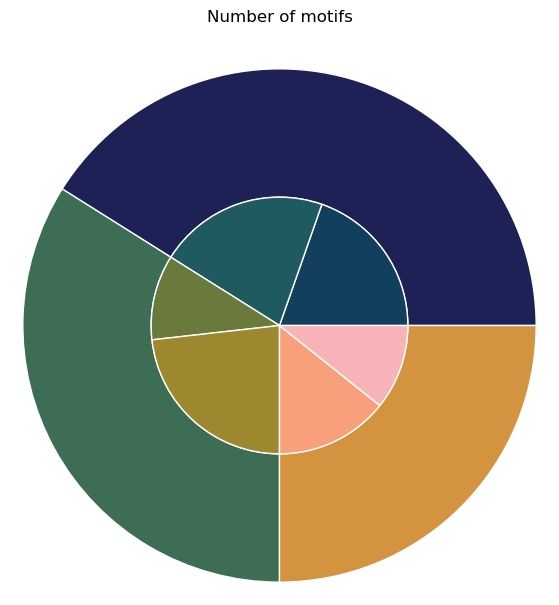

In [272]:
# Import libraries
from matplotlib import pyplot as plt
import numpy as np
 
 
size = 3
cars = ['Discrimative mode', 'Differential mode', 'Classic Meme']
 
data = np.array([[11,12],[6,13],[8,6]])
 
# normalizing data to 2 pi
norm = data / np.sum(data)*2 * np.pi
 
# obtaining ordinates of bar edges
left = np.cumsum(np.append(0,
                           norm.flatten()[:-1])).reshape(data.shape)
 
# Creating color scale

outer_colors = ['#1e2156','#3e6d55','#d3933f']
inner_colors = ['#133f5e','#1f5a61','#697a3c','#9d8830','#f8a07b','#f8b3b9']
 
# Creating plot
fig, ax = plt.subplots(figsize =(10, 7),
                       subplot_kw = dict(polar = True))
 
ax.bar(x = left[:, 0],
       width = norm.sum(axis = 1),
       bottom = 1-size,
       height = size,
       color = outer_colors,
       edgecolor ='w',
       linewidth = 1,
       align ="edge")
 
ax.bar(x = left.flatten(),
       width = norm.flatten(),
       bottom = 1-2 * size,
       height = size,
       color = inner_colors,
       edgecolor ='w',
       linewidth = 1,
       align ="edge")



ax.set(title ="Number of motifs")
ax.set_axis_off()

plt.savefig('../Pie_chart.pdf')
# Show plot
plt.show()


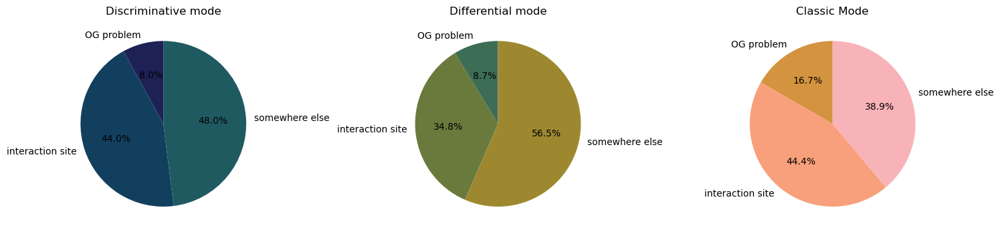

In [407]:
import numpy as np
import matplotlib.pyplot as plt

# Data
cars = ['Discriminative mode', 'Differential mode', 'Classic Mode']
data = np.array([[2,11, 12], [2,8, 13], [3,8, 7]])
inner_colors = ['#1e2156','#133f5e', '#1f5a61','#3e6d55', '#697a3c', '#9d8830','#d3933f', '#f8a07b', '#f8b3b9']

# Create subplots for the three pie charts
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

for i in range(3):
    labels = ['OG problem','interaction site', 'somewhere else']
    sizes = data[i, :]
    colors = inner_colors[i * len(labels): (i + 1) * len(labels)]

    axs[i].pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=colors)
    axs[i].set_title(cars[i])

plt.tight_layout()
plt.savefig('../Pie_chart_separate.pdf')
plt.show()

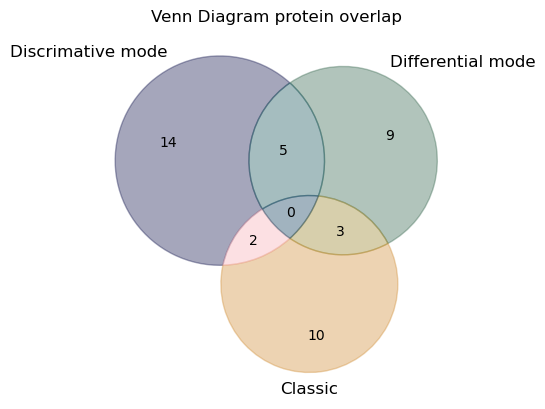

In [275]:
from matplotlib_venn import venn3
# Extract the first two words from each element
def extract_first_two_words(s):
    return s.split('_')[0] + '_' + s.split('_')[1]

set1 = set(map(extract_first_two_words, list_of_interst_discrimtaive))
set2 = set(map(extract_first_two_words, list_of_interst_differential))
set3 = set(map(extract_first_two_words, list_of_interst_classic))

# Create the Venn diagram
venn = venn3([set1, set2, set3], ('Discrimative mode', 'Differential mode', 'Classic'))


# Customize colors
venn.get_patch_by_id('100').set_color('#1e2156')
venn.get_patch_by_id('010').set_color('#3e6d55')
venn.get_patch_by_id('001').set_color('#d3933f')
venn.get_patch_by_id('110').set_color('#1f5a61')
venn.get_patch_by_id('011').set_color('#9d8830')
venn.get_patch_by_id('101').set_color('#f8b3b9')
venn.get_patch_by_id('111').set_color('#154360')


# Display the diagram
plt.title("Venn Diagram protein overlap")
plt.savefig('../Venn_diagram.pdf')
plt.show()

# Create distribution of r values

In [54]:
dat_differential
dat_discrimtaive
dat_classic

,correlation,pvalue,human_hsap
KOG2391@euNOG_KOG0665@euNOG_MEME-1,0.903205,5.715408e-57,1
KOG0787@euNOG_KOG4194@euNOG_MEME-1,0.877400,3.232305e-45,5
KOG2166@euNOG_KOG0281@euNOG_MEME-4,0.877391,6.626281e-53,2
KOG2292@euNOG_KOG2291@euNOG_MEME-7,0.870250,4.562876e-51,2
KOG3833@euNOG_KOG0349@euNOG_MEME-7,0.867104,4.449208e-35,1
...,...,...,...
KOG1350@euNOG_KOG3656@euNOG_MEME-4,-0.347312,8.907669e-06,1
KOG1350@euNOG_KOG3656@euNOG_MEME-3,-0.347312,8.907669e-06,1
KOG2523@euNOG_KOG0156@euNOG_MEME-7,-0.359951,2.939082e-06,1
KOG1350@euNOG_KOG3656@euNOG_MEME-6,-0.404707,1.605023e-07,1


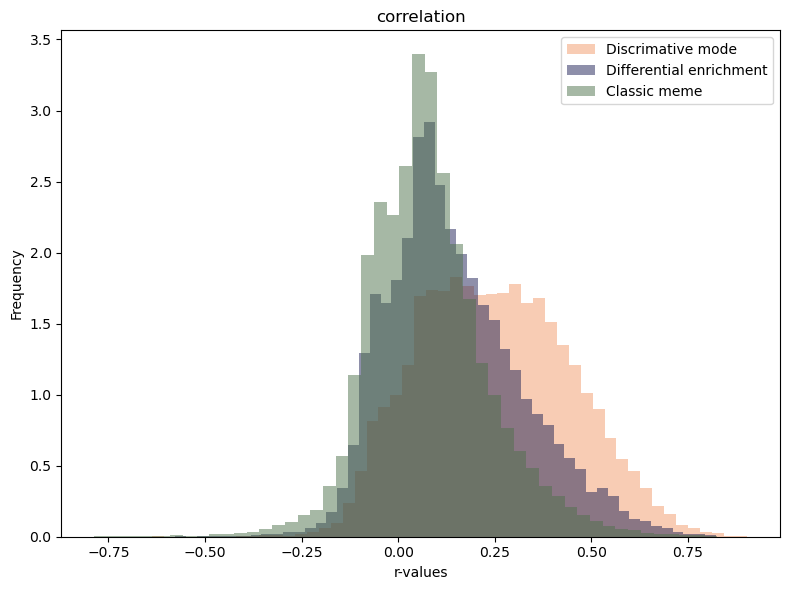

In [68]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create subplots for each column
fig, ax = plt.subplots(figsize=(8, 6))

# Plot distribution for DataFrame 1
ax.hist(dat_differential['correlation'].dropna(), bins=50, alpha=0.5, label='Discrimative mode', color='#F39B6A', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 2
ax.hist(dat_discrimtaive['correlation'].dropna(), bins=50, alpha=0.5, label='Differential enrichment', color='#1E2156', density=True)  # Adjust the number of bins as needed

# Plot distribution for DataFrame 3
ax.hist(dat_classic['correlation'].dropna(), bins=50, alpha=0.5, label='Classic meme', color='#4f724c', density=True)  # Adjust the number of bins as needed

ax.set_title('correlation')
ax.set_xlabel("r-values")
ax.set_ylabel("Frequency")
ax.legend()

# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.savefig('../distribution_pvalues.pdf')
plt.show()


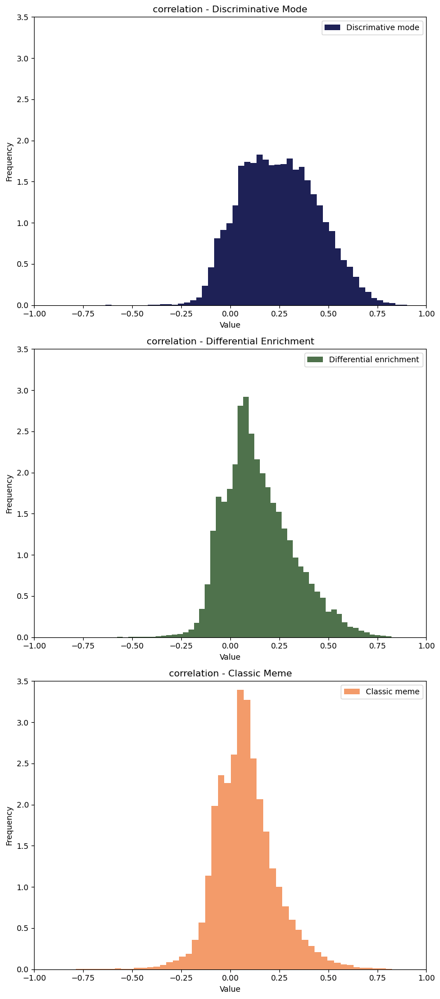

In [84]:
# Create subplots for each column - Three Separate Figures
fig, axs = plt.subplots(3, 1, figsize=(8, 18))  # 3 rows, 1 column

# Plot distribution for DataFrame 1
axs[0].hist(dat_differential['correlation'].dropna(), bins=50, alpha=1, label='Discrimative mode', color='#1E2156', density=True)  
axs[0].set_title('correlation - Discriminative Mode')
axs[0].set_xlabel("Value")
axs[0].set_ylabel("Frequency")
axs[0].legend()
axs[0].axis(xmin=-1,xmax=1,ymin=0,ymax=3.5)
# Plot distribution for DataFrame 2
axs[1].hist(dat_discrimtaive['correlation'].dropna(), bins=50, alpha=1, label='Differential enrichment', color='#4f724c', density=True)  
axs[1].set_title('correlation - Differential Enrichment')
axs[1].set_xlabel("Value")
axs[1].set_ylabel("Frequency")
axs[1].legend()
axs[1].axis(xmin=-1,xmax=1,ymin=0,ymax=3.5)
# Plot distribution for DataFrame 3
axs[2].hist(dat_classic['correlation'].dropna(), bins=50, alpha=1, label='Classic meme', color='#F39B6A', density=True)  
axs[2].set_title('correlation - Classic Meme')
axs[2].set_xlabel("Value")
axs[2].set_ylabel("Frequency")
axs[2].legend()
axs[2].axis(xmin=-1,xmax=1,ymin=0,ymax=3.5)
# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.savefig('../distribution_pvalues_sepperate.pdf')
plt.show()

In [98]:
import numpy as np
from scipy.stats import ks_2samp
diff_disc=ks_2samp(dat_differential['correlation'], dat_discrimtaive['correlation'])
diff_clasic=ks_2samp(dat_differential['correlation'], dat_classic['correlation'])
clasic_disc=ks_2samp(dat_classic['correlation'], dat_discrimtaive['correlation'])
# p-value = .95 (no significant difference)
print(diff_disc,diff_clasic,clasic_disc)

import numpy as np

# Calculate mean, median, standard deviation, and other statistics for DataFrame 1
mean_1 = np.mean(dat_differential['correlation'].dropna())
median_1 = np.median(dat_differential['correlation'].dropna())
std_dev_1 = np.std(dat_differential['correlation'].dropna())
# Add other statistics as needed

# Print the statistics for DataFrame 1
print("Statistics for DataFrame 1:")
print("Mean:", mean_1)
print("Median:", median_1)
print("Standard Deviation:", std_dev_1)
# Print other statistics as needed
print()

# Repeat the same process for DataFrame 2 and DataFrame 3
mean_2 = np.mean(dat_discrimtaive['correlation'].dropna())
median_2 = np.median(dat_discrimtaive['correlation'].dropna())
std_dev_2 = np.std(dat_discrimtaive['correlation'].dropna())

print("Statistics for DataFrame 2:")
print("Mean:", mean_2)
print("Median:", median_2)
print("Standard Deviation:", std_dev_2)
print()

mean_3 = np.mean(dat_classic['correlation'].dropna())
median_3 = np.median(dat_classic['correlation'].dropna())
std_dev_3 = np.std(dat_classic['correlation'].dropna())

print("Statistics for DataFrame 3:")
print("Mean:", mean_3)
print("Median:", median_3)
print("Standard Deviation:", std_dev_3)

KstestResult(statistic=0.23948903266625488, pvalue=0.0) KstestResult(statistic=0.3962445995001562, pvalue=0.0) KstestResult(statistic=0.16265684716682072, pvalue=5.41401e-317)
Statistics for DataFrame 1:
Mean: 0.24917580257176836
Median: 0.24137820595022477
Standard Deviation: 0.19552786115300935

Statistics for DataFrame 2:
Mean: 0.1457752308769177
Median: 0.11795356492391772
Standard Deviation: 0.1747307992422187

Statistics for DataFrame 3:
Mean: 0.077863603267748
Median: 0.0668837719943902
Standard Deviation: 0.1537170767660043
